In [1]:
import jax
import numpy as np
import pandas as pd
import jax.numpy as jnp
import matplotlib.pyplot as plt
import seaborn as sns
import colorcet as cc

from tqdm.auto import tqdm
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from aging.plotting import (
    figure,
    format_plots,
    add_identity,
    legend,
    PlotConfig,
    save_factory,
    COLORMAPS,
    PLOT_CONFIG,
)
from copy import deepcopy
from operator import or_
from toolz import reduce, valmap, keyfilter, pluck, drop
from aging.behavior.bio_age_model import (
    fit_model,
    masked_xval,
    raise_dim
)
from scipy.spatial.distance import pdist, squareform
from scipy.stats import ks_2samp
from itertools import product, combinations

In [2]:
def make_sex_age_plot(age_df, width, height):
    age_df = age_df.copy()
    boundaries = np.arange(age_df["labels"].max() + 2) - 0.5
    pal = sns.blend_palette([COLORMAPS.ont_male(255), COLORMAPS.ont_female(255)], as_cmap=True)
    fig = figure(width, height)
    age_df['floored_age'] = (age_df['true_ages'] * 7) // 7
    ax = sns.lineplot(
        data=age_df,
        x="floored_age",
        y="bio_ages",
        hue="labels",
        palette=[COLORMAPS.ont_male(255), COLORMAPS.ont_female(255)],
        legend=False,
        zorder=-1,
        lw=0.25,
        err_kws=dict(lw=0),
    )
    perm = np.random.permutation(len(age_df))
    im = ax.scatter(
        age_df["true_ages"].iloc[perm],
        age_df["bio_ages"].iloc[perm],
        c=age_df["labels"].iloc[perm],
        cmap=pal,
        vmin=0,
        vmax=1,
        s=2.5,
        lw=0,
    )
    cb = fig.colorbar(
        mappable=im,
        boundaries=boundaries,
        ax=ax,
        label="Sex",
    )
    cb.set_ticks(range(0, 2))
    cb.set_ticklabels(["Male", "Female"])
    add_identity(ax, c="k", ls="--", zorder=-2)
    ax.set(
        xlabel="Chronological age (weeks)",
        ylabel="Behavioral age (weeks)",
        aspect="equal",
        xlim=(0, 60),
    )
    sns.despine()
    return fig

In [3]:
format_plots()

from pathlib import Path
c = PlotConfig(save_path=Path('/n/scratch/users/w/wg41/figures/aging'))

# saver = save_factory(PLOT_CONFIG.save_path / "fig4-longv2-bambi", tight_layout=False)
saver = save_factory(c.save_path / "fig4-longv2-bambi", tight_layout=False)

In [4]:
def zscore(ser: pd.Series):
    return (ser - ser.mean()) / ser.std()


def demean(ser: pd.Series):
    return ser - ser.mean()


def quantile(n):
    def percentile_(x):
        return x.quantile(n)
    percentile_.__name__ = 'q_{:0.02f}'.format(n)
    return percentile_

In [5]:
def load_male_long_df():
    keep_syllables = np.loadtxt(
        # "/n/groups/datta/win/longtogeny/data/ontogeny/version_11/to_keep_syllables_raw.txt",
        '/n/scratch/users/w/wg41/ontogeny_data/version_11/to_keep_syllables_raw.txt',
        dtype=int,
    )
    df = pd.read_parquet(
        # "/n/groups/datta/win/longtogeny/data/ontogeny/version_11-1/longtogeny_v2_males_raw_counts_matrix_v00.parquet"
        "/n/scratch/users/w/wg41/ontogeny_data/version_11-1/longtogeny_v2_males_raw_counts_matrix_v00.parquet"
    )
    size_df = pd.read_parquet(
        # "/n/groups/datta/win/longtogeny/data/ontogeny/version_11-1/longtogeny_v2_males_mouse_area_df_v00.parquet"
        "/n/scratch/users/w/wg41/ontogeny_data/version_11-1/longtogeny_v2_males_mouse_area_df_v00.parquet"
    )

    df = df[keep_syllables]
    df = df.join(size_df[["quant_0.5"]])

    idx_names = df.index.names
    age = df.index.get_level_values("age")

    bins = pd.cut(age, 92, labels=False)

    sample = (
        df.reset_index().groupby(["mouse", bins], observed=True).first().droplevel(1)
    )
    sample = sample.reset_index().set_index(idx_names)

    age_cut = pd.cut(sample.index.get_level_values("age"), 21)

    sample["quant_0.5"] = zscore(
        sample.groupby(age_cut, observed=True)["quant_0.5"].transform(demean)
    )

    return sample


def load_female_long_df():
    keep_syllables = np.loadtxt(
        # "/n/groups/datta/win/longtogeny/data/ontogeny/version_11/to_keep_syllables_raw.txt",
        '/n/scratch/users/w/wg41/ontogeny_data/version_11/to_keep_syllables_raw.txt',
        dtype=int,
    )
    df = pd.read_parquet(
        # "/n/groups/datta/win/longtogeny/data/ontogeny/version_11-1/longtogeny_v2_females_raw_counts_matrix_v00.parquet"
        "/n/scratch/users/w/wg41/ontogeny_data/version_11-1/longtogeny_v2_females_raw_counts_matrix_v00.parquet"
    )
    size_df = pd.read_parquet(
        # "/n/groups/datta/win/longtogeny/data/ontogeny/version_11-1/longtogeny_v2_females_mouse_area_df_v00.parquet"
        "/n/scratch/users/w/wg41/ontogeny_data/version_11-1/longtogeny_v2_females_mouse_area_df_v00.parquet"
    )

    df = df[keep_syllables]
    df = df.join(size_df[["quant_0.5"]])

    idx_names = df.index.names
    age = df.index.get_level_values("age")

    bins = pd.cut(age, 92, labels=False)

    sample = (
        df.reset_index().groupby(["mouse", bins], observed=True).first().droplevel(1)
    )
    sample = sample.reset_index().set_index(idx_names)

    age_cut = pd.cut(sample.index.get_level_values("age"), 21)

    sample["quant_0.5"] = zscore(
        sample.groupby(age_cut, observed=True)["quant_0.5"].transform(demean)
    )

    return sample

In [6]:
m_df = load_male_long_df()
m_size_col = m_df['quant_0.5']
m_df = m_df.drop(columns=['quant_0.5'])

f_df = load_female_long_df()
f_size_col = f_df['quant_0.5']
f_df = f_df.drop(columns=['quant_0.5'])

df = pd.concat([m_df, f_df])
size_col = pd.concat([m_size_col, f_size_col])
sort_idx = np.argsort(df.to_numpy().sum(0))[::-1]

label_encoder = OneHotEncoder(sparse_output=False, dtype=np.float32)
sex_id = label_encoder.fit_transform(np.hstack([np.zeros(len(df) - len(f_df)), np.ones(len(f_df))])[:, None]).T

mouse_ids = label_encoder.fit_transform(df.index.get_level_values("mouse").to_numpy()[:, None]).T
mouse_cat = label_encoder.categories_[0]

syllable_counts_jax = jnp.array(df.astype('float32'))
age = jnp.array(df.index.get_level_values('age'))
assert size_col.isna().sum() == 0, "issue with NaNs in size data"

In [7]:
df['sex'] = np.argmax(sex_id, axis=0)
df = df.set_index('sex', append=True)

In [8]:
animals_per_sex = df.reset_index().groupby('sex')['mouse'].nunique().tolist()

In [9]:
features = {
    "ages": age,  # models >= 1
    "counts": syllable_counts_jax + 1,  # models >= 1
    "sizes": size_col.to_numpy(),  # models > 1
    "sex": sex_id,
    "mice": mouse_ids,
}

age_sd = 0.04

hypparams = {
    "log_age": True,
    "min_age": 3,
    "max_age": 130,
    "age_sd": age_sd,
    "n_age_samples": 1000,
    "n_splines": 4,
    "n_syllables": syllable_counts_jax.shape[1],
    "n_development_splines": 4,
    "n_sex_splines": 4,
    "scale": 400,
    "normalize_by_softmax": True,
    "n_keep_sylls": 25,
    "n_sessions": len(syllable_counts_jax),
    "n_animals": len(mouse_ids),
    "n_animals_per_sex": animals_per_sex,
    "n_sexes": len(sex_id),
    "lr": 0.25,
    "n_opt_iter": 930,
}

In [10]:
mdl = fit_model(features, hypparams, 6)

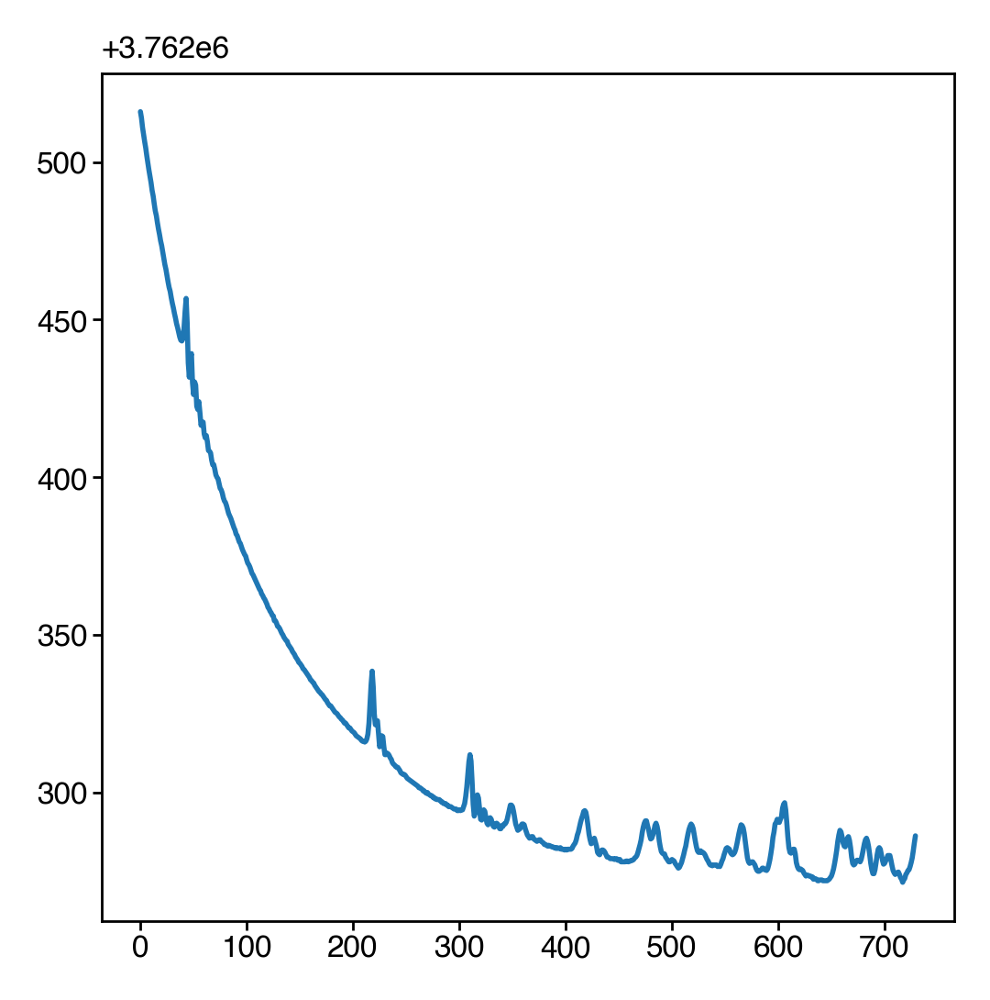

In [11]:
plt.plot(mdl['loss'][200:])

In [12]:
df_copy = df.copy().astype('float32')

# normalize to sum to 1
df_copy['beh_age'] = mdl['bio_ages']

In [13]:
for s, _df in df_copy.groupby('sex'):
    _age = _df.index.get_level_values('age').sort_values()
    _df = _df.sort_values(by='beh_age')
    df_copy.loc[_df.index, 'beh_age_map'] = _age.to_numpy()

df_copy = df_copy.set_index(['beh_age', 'beh_age_map'], append=True)

In [14]:
# df_copy.to_parquet(
#     "/n/groups/datta/win/longtogeny/data/ontogeny/version_11-1/beh_age_df/2024-06-11-male-female-long-v2-counts-df-beh-age.parquet"
# )

In [15]:
# to send to dana
df_copy_age_remap = df_copy.copy()
df_copy_age_remap.index = df_copy.droplevel('age').index.rename({'beh_age_map': 'age'})
df_copy_age_remap = df_copy_age_remap / df_copy_age_remap.sum(1).to_numpy()[:, None]

# df_copy_age_remap.query("sex == 0").to_parquet(
#     "/n/groups/datta/win/longtogeny/data/ontogeny/version_11-1/beh_age_df/long_v2_males_raw_usage_df_beh_age.parquet"
# )
# df_copy_age_remap.query("sex == 1").to_parquet(
#     "/n/groups/datta/win/longtogeny/data/ontogeny/version_11-1/beh_age_df/long_v2_females_raw_usage_df_beh_age.parquet"
# )

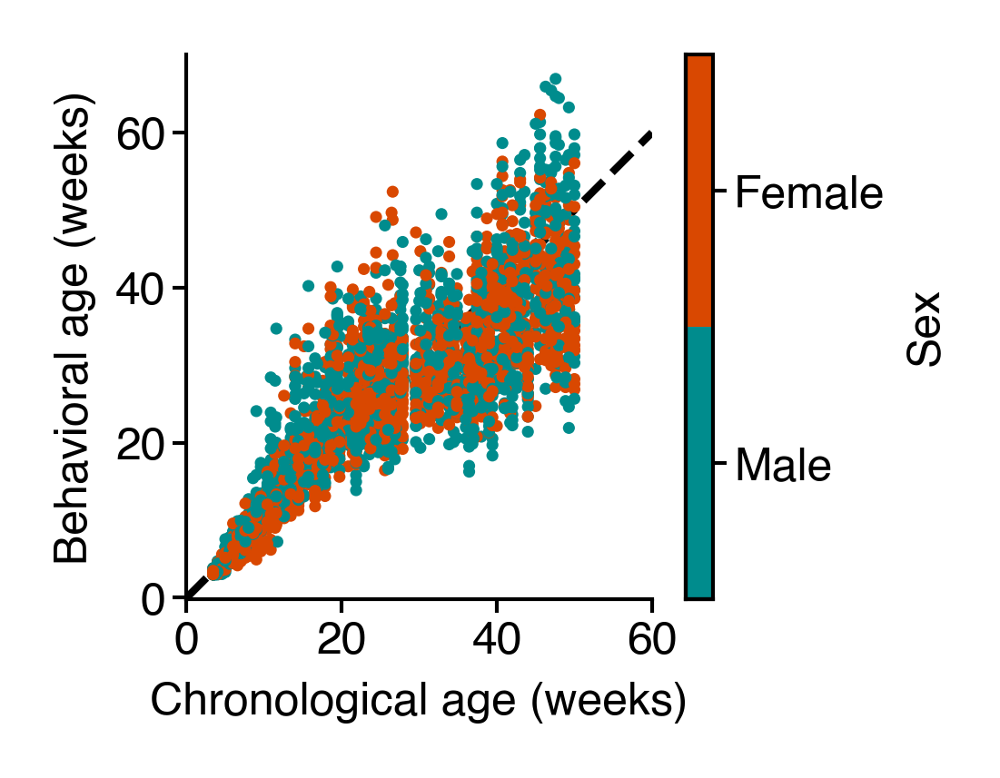

In [16]:
age_df = pd.DataFrame(
    dict(bio_ages=mdl["bio_ages"], true_ages=mdl["true_ages"], labels=np.argmax(features['sex'], axis=0)),
)

fig = make_sex_age_plot(age_df, 1.6, 1.3)
saver(fig, "long-v2-sex-chron-vs-beh-age-all-timepoints");

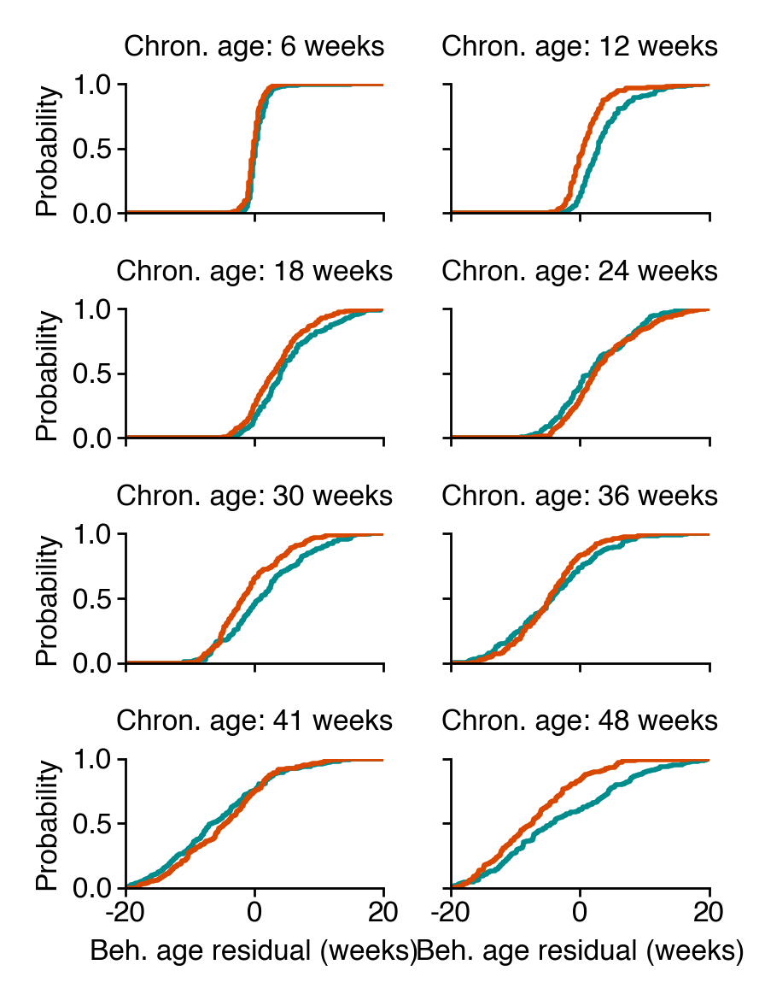

In [17]:
lims = 20
age_df['bin'] = pd.cut(age_df['true_ages'], 8, labels=False)
fig, ax = plt.subplots(4, 2, figsize=(2.2, 2.9), sharey=True, sharex=True)
for a, (_bin, _df) in zip(ax.flat, age_df.groupby("bin")):
    mean_age = _df["true_ages"].mean()
    _male_df = _df.query("labels == 0")
    _female_df = _df.query("labels == 1")
    sns.histplot(
        data=_male_df["bio_ages"] - _male_df['true_ages'],
        ax=a,
        color=COLORMAPS.ont_male(255),
        bins=np.linspace(-lims, lims, 200),
        fill=False,
        cumulative=True,
        element="step",
        stat='probability',
    )
    sns.histplot(
        data=_female_df["bio_ages"] - _female_df['true_ages'],
        ax=a,
        color=COLORMAPS.ont_female(255),
        bins=np.linspace(-lims, lims, 200),
        fill=False,
        cumulative=True,
        element="step",
        stat='probability',
    )
    a.set(title=f"Chron. age: {mean_age:0.0f} weeks", ylim=(0, 1))
for a in ax[-1]:
    a.set(xlabel="Beh. age residual (weeks)", xlim=(-lims, lims))
sns.despine()
fig.tight_layout()
saver(fig, "male-female-difference-to-avg-chron-age");

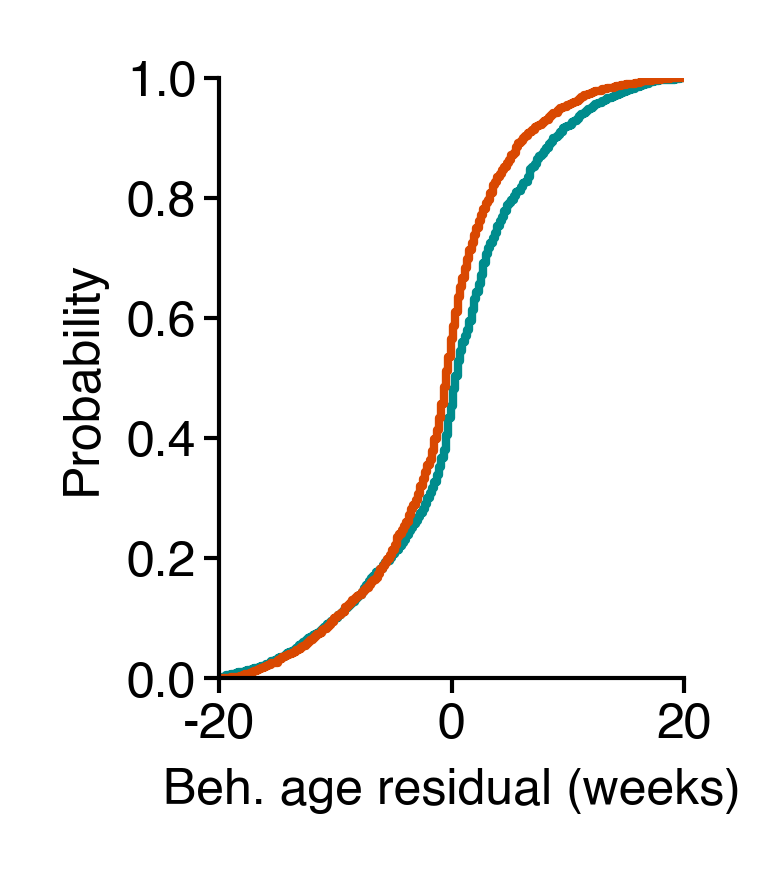

In [18]:
lims = 20
fig = figure(1, 1.3)
_male_df = age_df.query("labels == 0")
_female_df = age_df.query("labels == 1")
sns.histplot(
    data=_male_df["bio_ages"] - _male_df['true_ages'],
    color=COLORMAPS.ont_male(255),
    bins=np.linspace(-lims, lims, 200),
    fill=False,
    cumulative=True,
    element="step",
    stat='probability',
)
a = sns.histplot(
    data=_female_df["bio_ages"] - _female_df['true_ages'],
    color=COLORMAPS.ont_female(255),
    bins=np.linspace(-lims, lims, 200),
    fill=False,
    cumulative=True,
    element="step",
    stat='probability',
)
a.set(xlabel="Beh. age residual (weeks)", xlim=(-lims, lims), ylim=(0, 1))
sns.despine()
saver(fig, "male-female-difference-to-avg-chron-age-all");

In [19]:
ks_result = ks_2samp(_male_df['bio_ages'] - _male_df['true_ages'], _female_df['bio_ages'] - _female_df['true_ages'])
ks_result

KstestResult(statistic=0.1159870933936377, pvalue=1.1566396253228564e-09, statistic_location=1.458044, statistic_sign=-1)

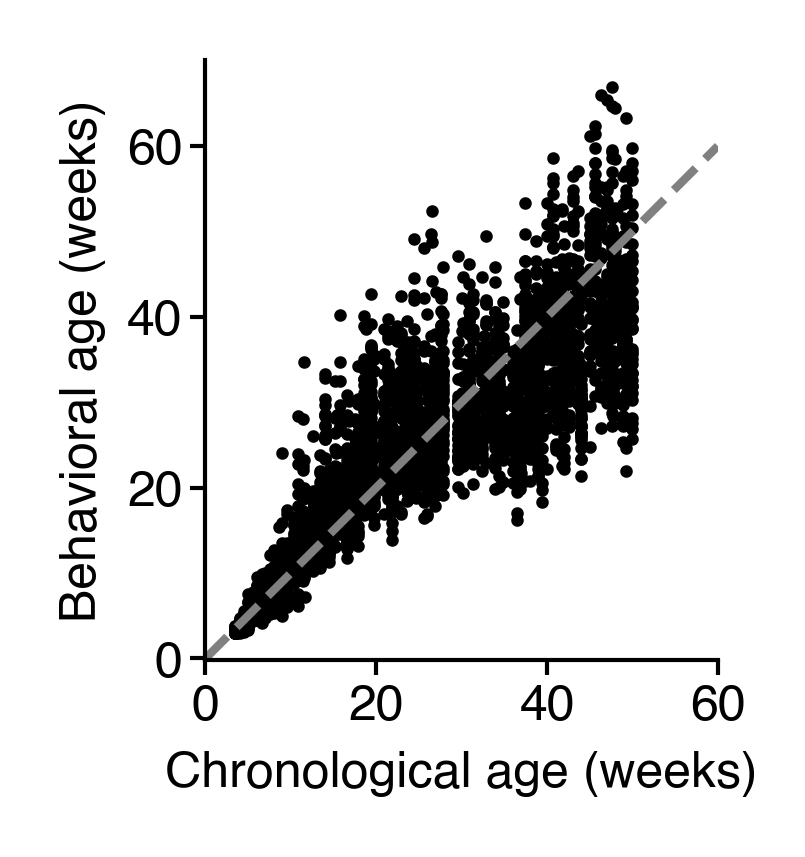

In [20]:
fig = figure(1.3, 1.3)
ax = fig.gca()
ax.scatter(mdl["true_ages"], mdl["bio_ages"], color="k", s=0.5)
ax.set(
    xlabel="Chronological age (weeks)",
    ylabel="Behavioral age (weeks)",
    aspect="equal",
    xlim=(0, 60),
)
add_identity(ax, color="gray", ls="--", zorder=1)
sns.despine()
saver(fig, "long-v2-bio-ages");

In [21]:
df_copy = df.copy().astype('float32')

# normalize to sum to 1
df_copy = df_copy / (df_copy.sum(1).to_numpy()[:, None])
df_copy['beh_age'] = mdl['bio_ages']
# df_copy['sex'] = np.argmax(sex_id, axis=0)
df_copy = df_copy.set_index('beh_age', append=True)

df_copy['age_bin'] = pd.cut(df_copy.index.get_level_values('age'), 30, labels=False)
df_copy['beh_age_bin'] = pd.cut(df_copy.index.get_level_values('beh_age'), 30, labels=False)
df_copy = df_copy.set_index(['beh_age_bin', 'age_bin'], append=True)

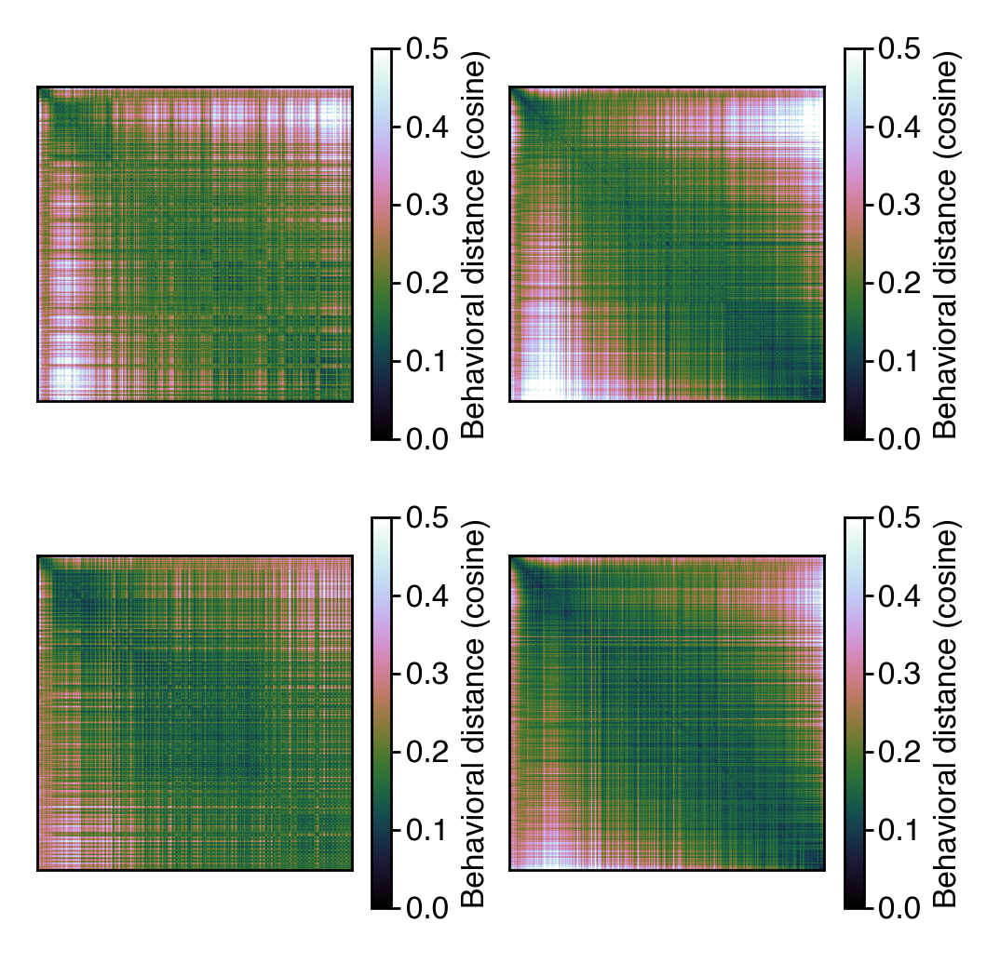

In [22]:
fig, ax = plt.subplots(2, 2, figsize=(3, 3))

sex_vmap = {
    0: 0.5,
    1: 0.5,
}

for (_sex, _sorting), a in zip(product([0, 1], ["age", "beh_age"]), ax.flat):
    d = pdist(df_copy.query('sex == @_sex').sort_index(level=_sorting), metric="cosine")
    d = squareform(d)

    im = a.imshow(d, cmap="cubehelix", vmax=sex_vmap[_sex], vmin=0)
    fig.colorbar(im, ax=a, label="Behavioral distance (cosine)")
    a.set(xticks=[], yticks=[])
saver(fig, 'long-v2-male-female-distance-matrix-pre-post-bambi-sorting-cosine');

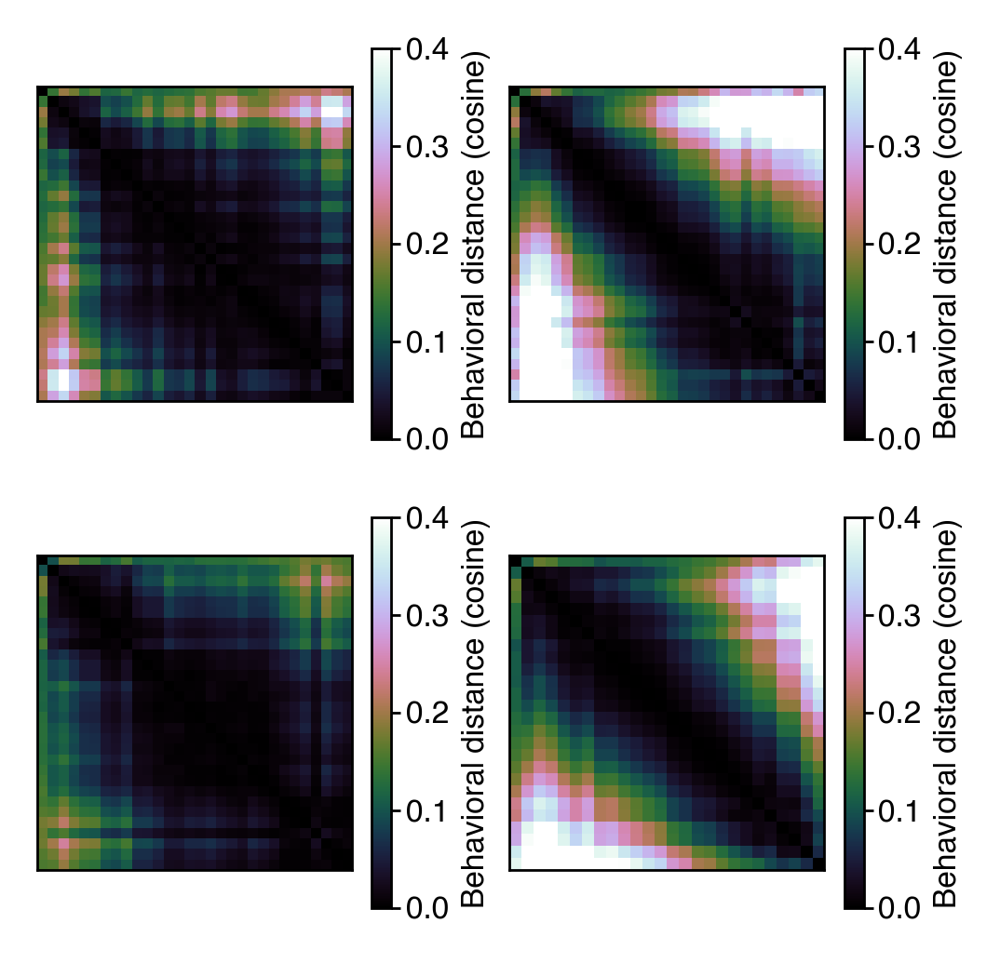

In [23]:
fig, ax = plt.subplots(2, 2, figsize=(3, 3))

sex_vmap = {
    0: 0.4,
    1: 0.4,
}

for (_sex, _sorting), a in zip(product([0, 1], ["age_bin", "beh_age_bin"]), ax.flat):
    d = pdist(df_copy.query('sex == @_sex').groupby(_sorting).mean(), metric="cosine")
    d = squareform(d)

    im = a.imshow(d, cmap="cubehelix", vmax=sex_vmap[_sex], vmin=0)
    fig.colorbar(im, ax=a, label="Behavioral distance (cosine)")
    a.set(xticks=[], yticks=[])
saver(fig, 'long-v2-male-female-averaged-distance-matrix-pre-post-bambi-sorting-cosine');

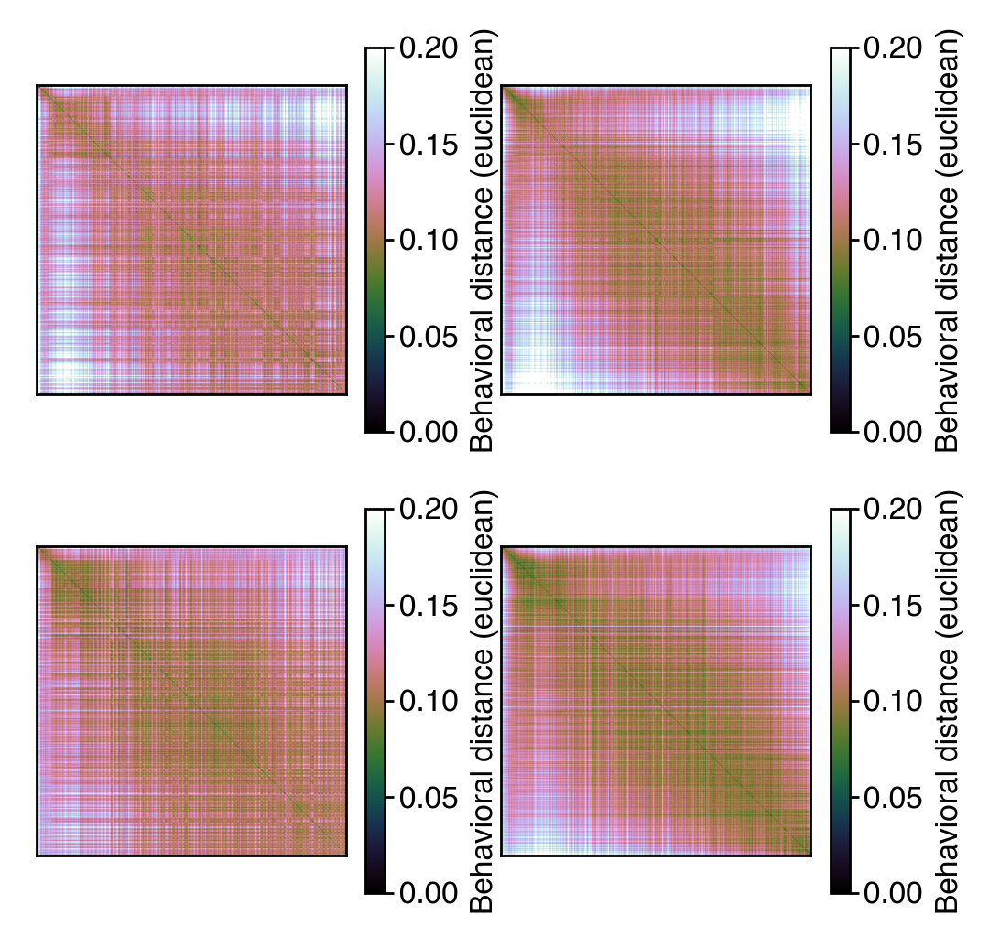

In [25]:
fig, ax = plt.subplots(2, 2, figsize=(3, 3))

sex_vmap = {
    0: 0.2,
    1: 0.2,
}

for (_sex, _sorting), a in zip(product([0, 1], ["age", "beh_age"]), ax.flat):
    d = pdist(df_copy.query('sex == @_sex').sort_index(level=_sorting), metric="euclidean")
    d = squareform(d)

    im = a.imshow(d, cmap="cubehelix", vmax=sex_vmap[_sex], vmin=0)
    fig.colorbar(im, ax=a, label="Behavioral distance (euclidean)")
    a.set(xticks=[], yticks=[])
# saver(fig, 'long-v2-male-female-distance-matrix-pre-post-bambi-sorting-euclidean');

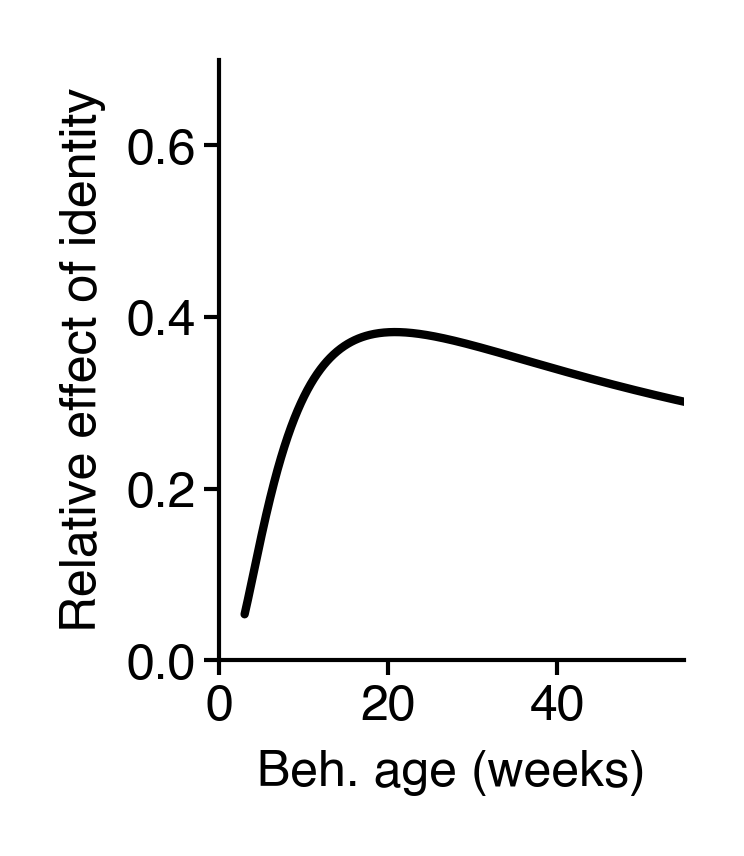

In [26]:
x = mdl['params']['development_weights']
dev = (x @ mdl['init_components'].bases['development']).squeeze()

comps = mdl['init_components']

# dev = np.exp(dev - dev.max())
dev = np.exp(dev)

fig = figure(1, 1.3)
ax = fig.gca()
ax.plot(comps.age_unnormalizer(comps.age_samples), dev, color='k')
plt.xlim(0, 55)
plt.ylim(0, 0.7)
plt.xlabel("Beh. age (weeks)")
plt.ylabel("Relative effect of identity")
sns.despine()
saver(fig, "long-v2-effect-of-id");

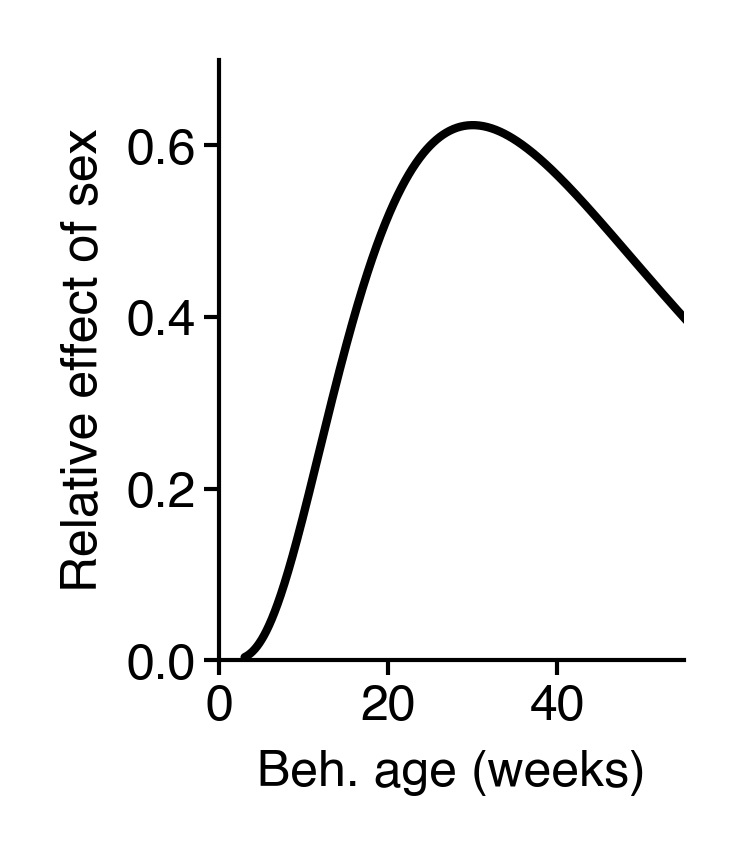

In [27]:
x = mdl['params']['sex_weights']
dev = (x @ mdl['init_components'].bases['sex']).squeeze()

comps = mdl['init_components']

# dev = np.exp(dev - dev.max())
dev = np.exp(dev)

fig = figure(1, 1.3)
ax = fig.gca()
ax.plot(comps.age_unnormalizer(comps.age_samples), dev, color='k')
plt.xlim(0, 55)
plt.ylim(0, 0.7)
plt.xlabel("Beh. age (weeks)")
plt.ylabel("Relative effect of sex")
sns.despine()
saver(fig, "long-v2-effect-of-sex");

In [28]:
age_df = pd.DataFrame(
    dict(bio_ages=mdl["bio_ages"], true_ages=mdl["true_ages"], labels=np.argmax(features['mice'], axis=0),
         sex=np.argmax(features['sex'], axis=0)),
    index=df.index
)

In [29]:
def make_id_plot(age_df, width, height, hue_order=None, include_lines=False, ax_kwargs={}):
    age_df = age_df.copy()
    # age_df['floored_age'] = ((age_df['true_ages'] * 7) // 14) * 2

    min_label = age_df['labels'].min()
    age_df['labels'] = age_df['labels'] - min_label
    boundaries = np.arange(age_df["labels"].max() + 2) - 0.5
    fig = figure(width, height)
    ax = fig.gca()
    if hue_order is None:
        pal = cc.glasbey[min_label: age_df["labels"].max() + 1 + min_label]
    else:
        pal = [cc.glasbey[hue] for hue in hue_order]
    if include_lines:
        ax = sns.lineplot(
            data=age_df,
            x="true_ages",
            y="bio_ages",
            hue="labels",
            palette=pal,
            hue_order=hue_order,
            legend=False,
            zorder=-1,
            lw=0.25, err_kws=dict(lw=0), ax=ax
        )
    if hue_order is not None:
        age_df = age_df[age_df['labels'].isin(hue_order)]
    im = ax.scatter(
        age_df["true_ages"],
        age_df["bio_ages"],
        c=age_df["labels"],
        cmap=cc.cm.glasbey,
        vmin=0 - min_label,
        vmax=256 - min_label,
        s=4,
        lw=0,
    )
    cb = fig.colorbar(
        mappable=im,
        boundaries=boundaries,
        ax=ax,
        label="Mouse ID",
    )
    cb.set_ticks(range(0, age_df['labels'].nunique() + 1, 3))
    add_identity(ax, c="k", ls="--", zorder=-2)
    ax.set(
        xlabel="Chronological age (weeks)",
        ylabel="Behavioral age (weeks)",
        aspect="equal",
        ylim=(0, 80),
        **ax_kwargs
    )
    sns.despine()
    return fig

In [30]:
male = age_df.query('sex==0').copy()
female = age_df.query('sex==1').copy()

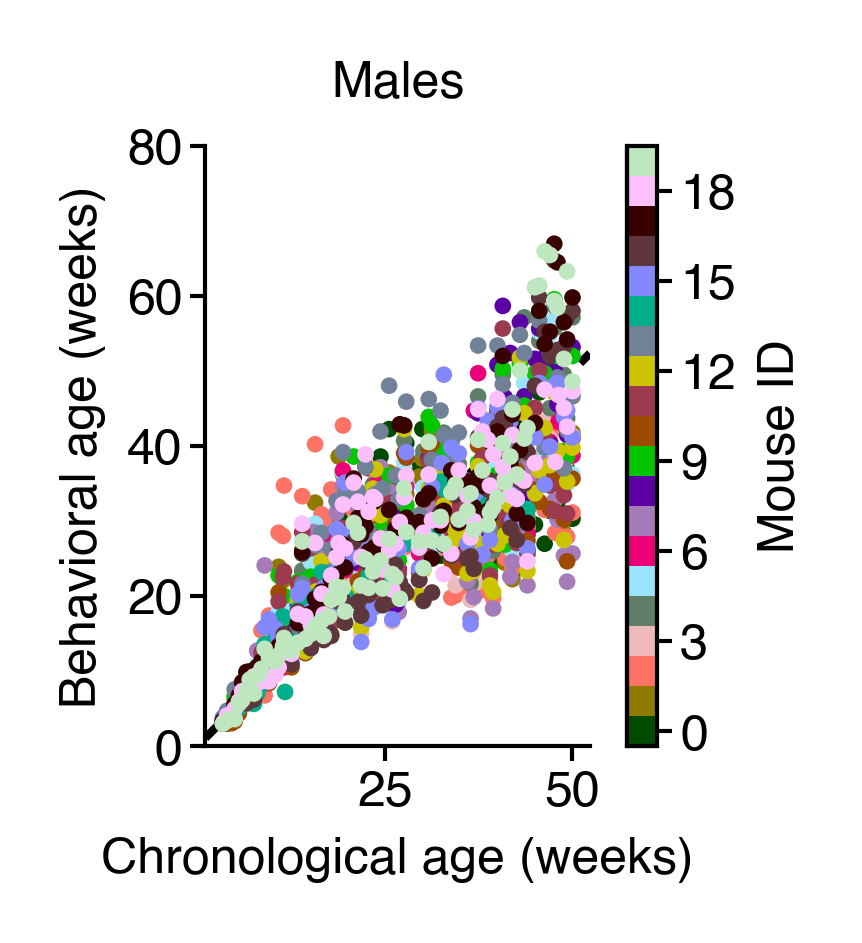

In [31]:
fig = make_id_plot(male, 1.6, 1.3, ax_kwargs=dict(title="Males"))
saver(fig, "long-v2-id-males-chron-vs-beh-age-all-timepoints");

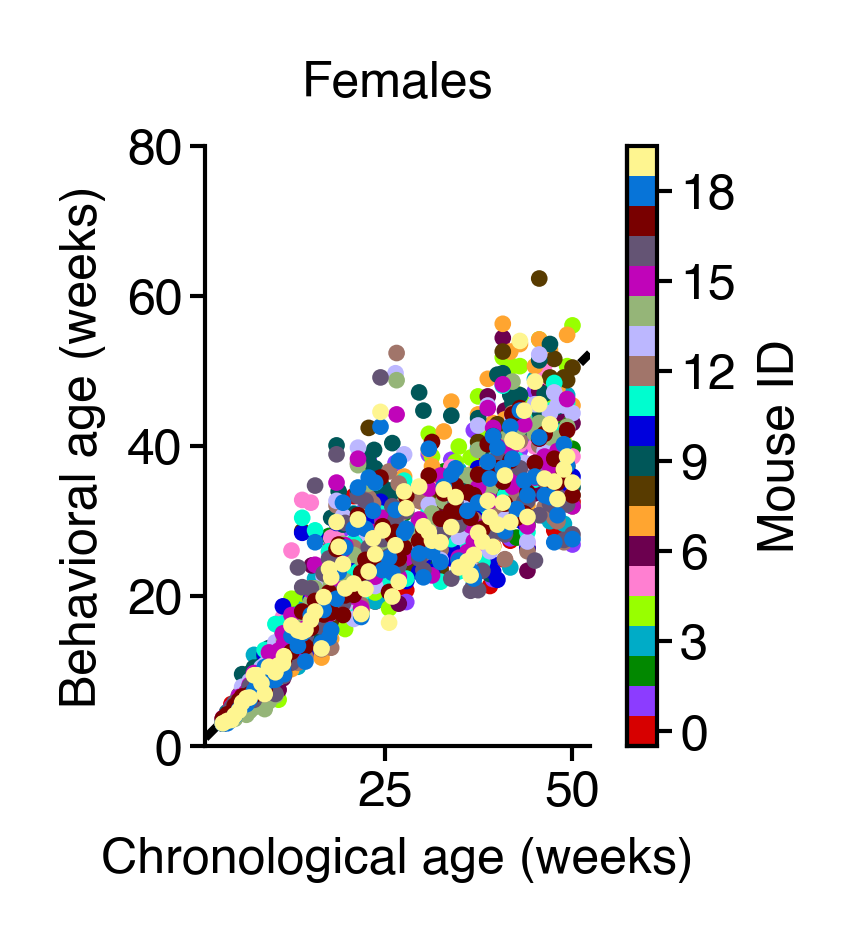

In [32]:
fig = make_id_plot(female, 1.6, 1.3, ax_kwargs=dict(title="Females"))
saver(fig, "long-v2-id-females-chron-vs-beh-age-all-timepoints");

In [52]:
male["smoothed_bio_age"] = male.groupby("mouse")["bio_ages"].transform(
    lambda x: x.rolling(7, center=True, win_type="exponential", min_periods=1).mean(
        tau=1.3
    )
)
female["smoothed_bio_age"] = female.groupby("mouse")["bio_ages"].transform(
    lambda x: x.rolling(7, center=True, win_type="exponential", min_periods=1).mean(
        tau=1.3
    )
)

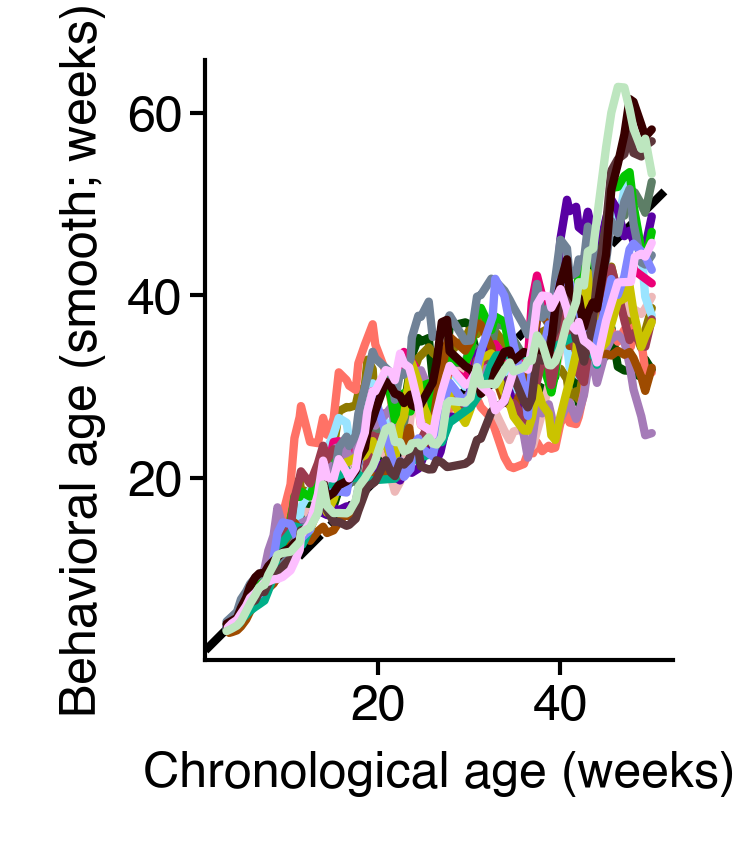

In [34]:
fig = figure(1.5, 1.3)
ax = sns.lineplot(
    data=male,
    x="true_ages",
    y="smoothed_bio_age",
    hue="labels",
    palette=cc.glasbey[20:40],
    legend=False,
    # hue_order=[idx[0], idx[1], idx[-2], idx[-1]]
)
ax.set(
    aspect="equal",
    xlabel="Chronological age (weeks)",
    ylabel="Behavioral age (smooth; weeks)",
)
add_identity(ax, c="k", ls="--", zorder=-1)
sns.despine()
saver(fig, "smoothed-male-bio-age-for-individuals");

In [56]:
x = male.reset_index(level='age')
x['diff'] = x['bio_ages'] - x['age']
x['diff_smooth'] = x['diff'].rolling(9, center=True, min_periods=1).median()

mouse_residuals = x.groupby('labels')['diff_smooth'].median()

## Four male examples

In [57]:
idx = mouse_residuals.sort_values().index
hue_order = idx[np.linspace(0, len(idx) - 1, 5, dtype=int)]

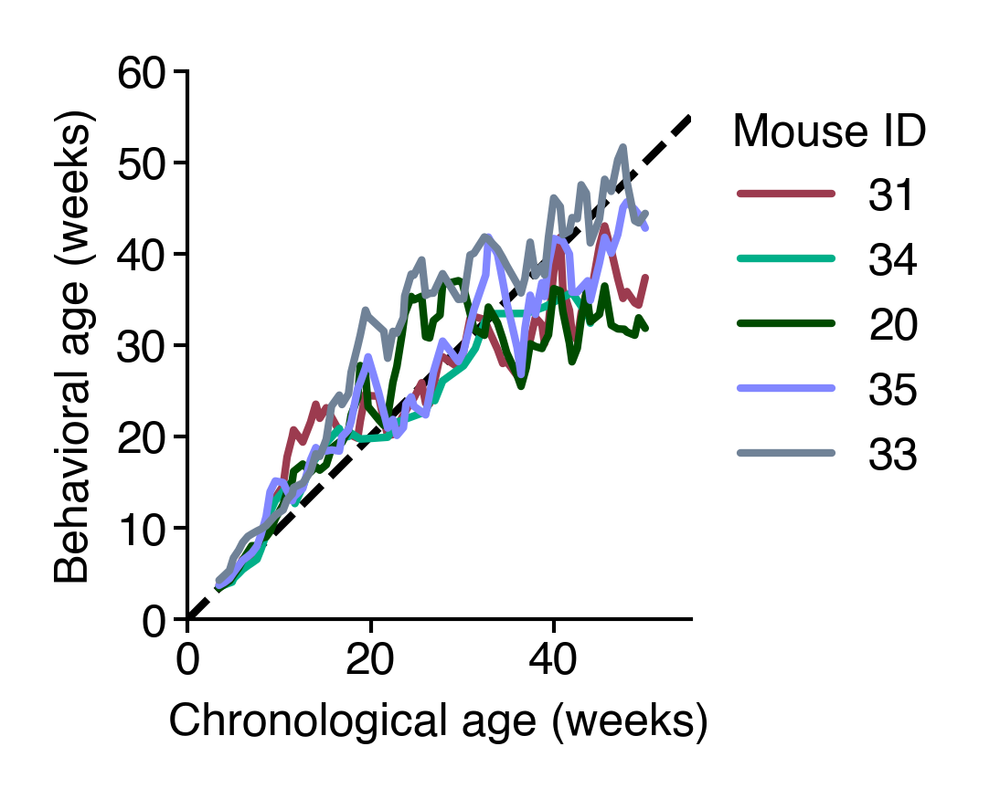

In [58]:
colors = [cc.glasbey[i] for i in hue_order]

fig = figure(1.5, 1.3)

ax = sns.lineplot(
    data=male,
    x="true_ages",
    y="smoothed_bio_age",
    hue="labels",
    palette=colors,
    legend=True,
    hue_order=hue_order,
)

ax.set(
    aspect="equal",
    xlabel="Chronological age (weeks)",
    ylabel="Behavioral age (weeks)",
    xlim=(0, 55),
    ylim=(0, 60),
)
add_identity(ax, c="k", ls="--", zorder=-1)
legend(ax, title="Mouse ID")
sns.despine()
saver(fig, "smoothed-male-bio-age-5-examples-for-individuals");

## Two male examples

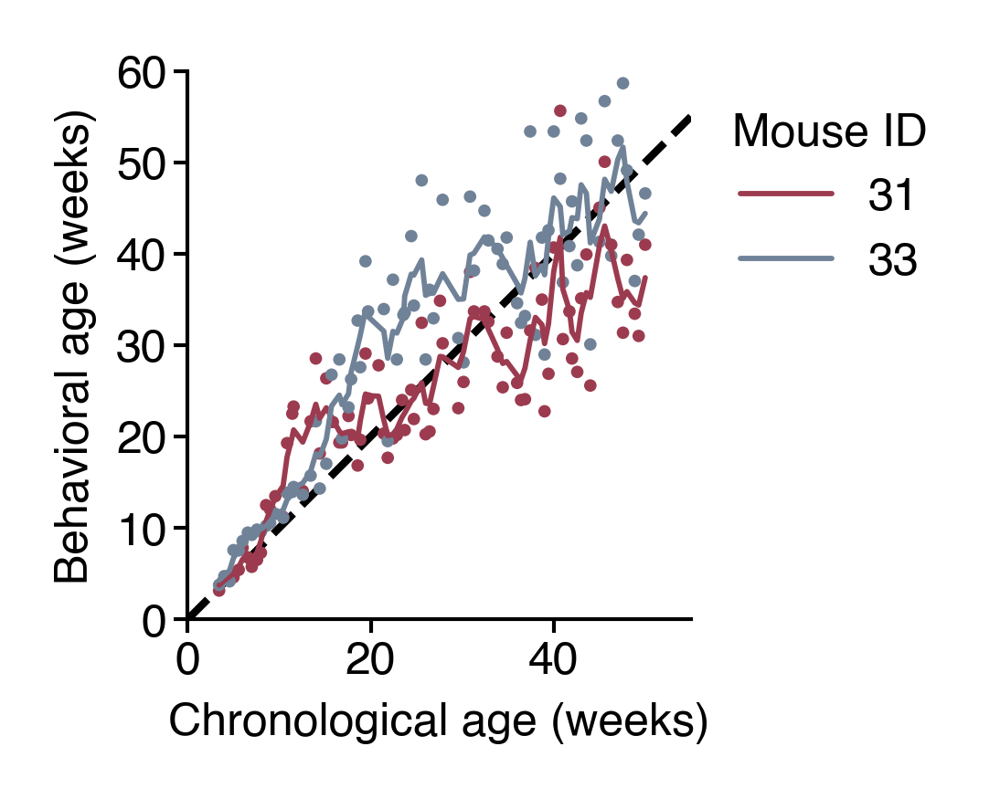

In [59]:
idx = mouse_residuals.sort_values().index
hue_order = idx[[0, -1]]
colors = [cc.glasbey[i] for i in hue_order]

fig = figure(1.5, 1.3)
ax = sns.scatterplot(
    data=male,
    x="true_ages",
    y="bio_ages",
    hue="labels",
    palette=colors,
    legend=False,
    lw=0,
    s=2.7,
    hue_order=hue_order,
)

ax = sns.lineplot(
    data=male,
    x="true_ages",
    y="smoothed_bio_age",
    hue="labels",
    palette=colors,
    legend=True,
    hue_order=hue_order,
    lw=0.7,
)

ax.set(
    aspect="equal",
    xlabel="Chronological age (weeks)",
    ylabel="Behavioral age (weeks)",
    xlim=(0, 55),
    ylim=(0, 60),
)
add_identity(ax, c="k", ls="--", zorder=-1)
legend(ax, title="Mouse ID")
sns.despine()
saver(fig, "smoothed-male-bio-age-examples-for-individuals");

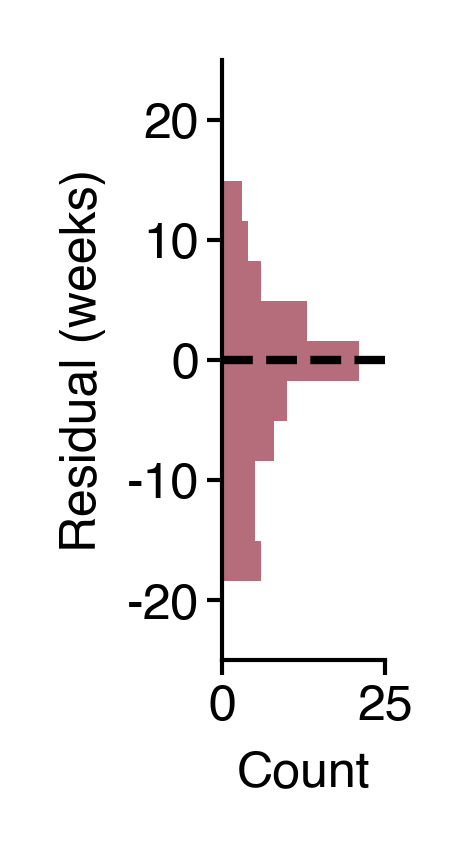

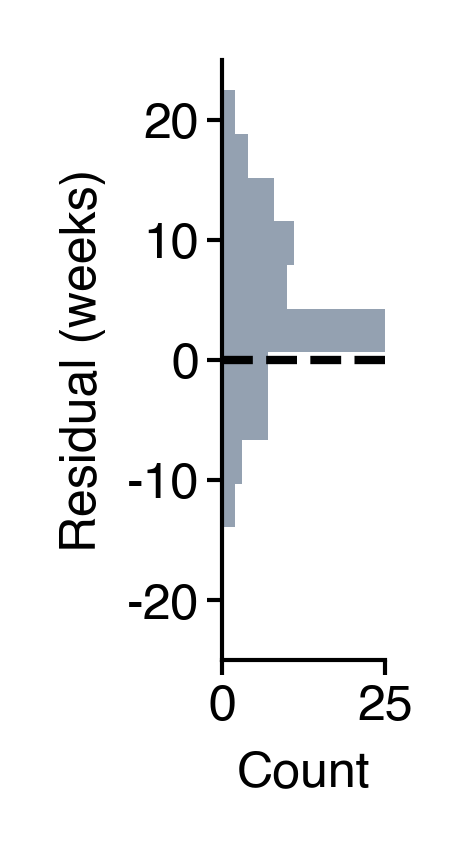

In [60]:
for mouse in idx[[0, -1]]:
    color = cc.glasbey[mouse]
    fig = figure(0.35, 1.3)
    ax = sns.histplot(y=x.query('labels == @mouse')['diff'], element='step', lw=0, bins=10, color=color)
    ax.axhline(0, color='k', ls='--')
    ax.set(ylabel="Residual (weeks)", ylim=(-25, 25), xlim=(0, 25))
    sns.despine()
    saver(fig, f"male-mouse-example-residuals-{mouse}")

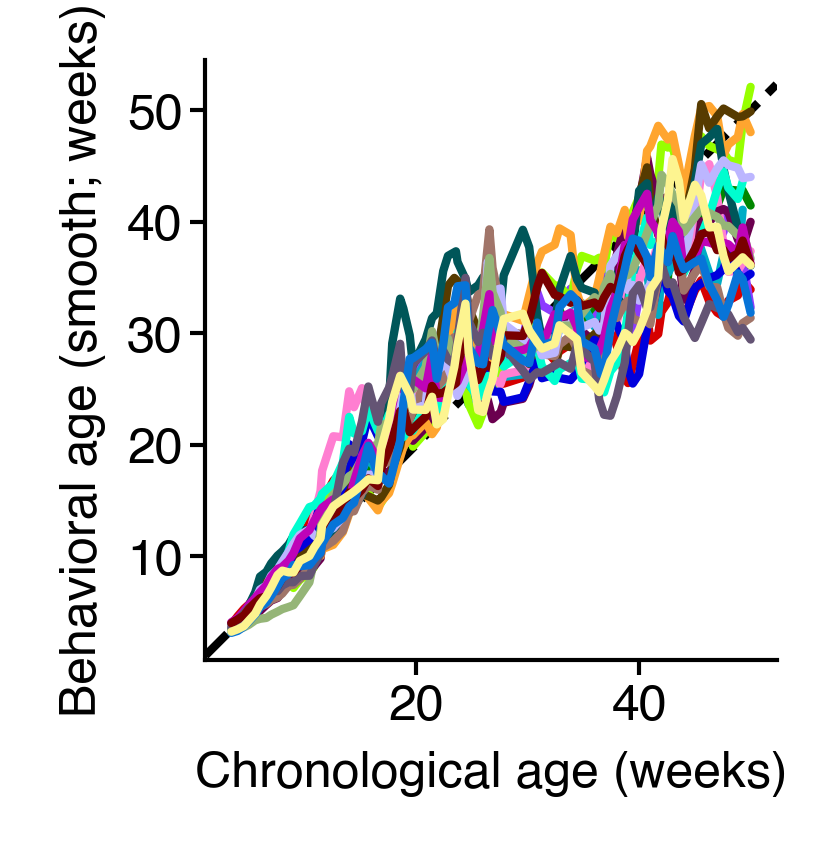

In [61]:
fig = figure(1.5, 1.3)
ax = sns.lineplot(
    data=female,
    x="true_ages",
    y="smoothed_bio_age",
    hue="labels",
    palette=cc.glasbey[:20],
    legend=False,
)
ax.set(
    aspect="equal",
    xlabel="Chronological age (weeks)",
    ylabel="Behavioral age (smooth; weeks)",
)
add_identity(ax, c="k", ls="--", zorder=-1)
sns.despine()
saver(fig, "smoothed-female-bio-age-for-individuals");

In [62]:
x = female.reset_index(level='age')
x['diff'] = x['bio_ages'] - x['age']
x['diff_smooth'] = x['diff'].rolling(9, center=True, min_periods=1).median()

mouse_residuals = x.groupby('labels')['diff_smooth'].median()

## Four female examples

In [63]:
idx = mouse_residuals.sort_values().index
hue_order = idx[np.linspace(0, len(idx) - 1, 5, dtype=int)]

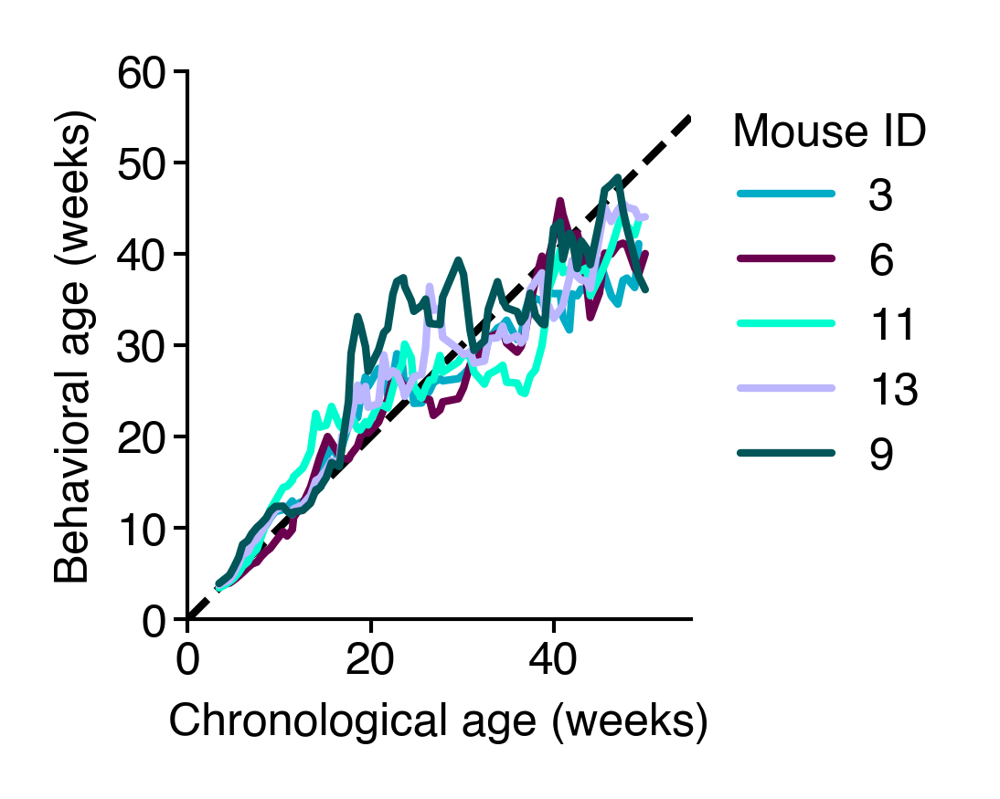

In [64]:
colors = [cc.glasbey[i] for i in hue_order]

fig = figure(1.5, 1.3)

ax = sns.lineplot(
    data=female,
    x="true_ages",
    y="smoothed_bio_age",
    hue="labels",
    palette=colors,
    legend=True,
    hue_order=hue_order,
)

ax.set(
    aspect="equal",
    xlabel="Chronological age (weeks)",
    ylabel="Behavioral age (weeks)",
    xlim=(0, 55),
    ylim=(0, 60),
)
add_identity(ax, c="k", ls="--", zorder=-1)
legend(ax, title="Mouse ID")
sns.despine()
saver(fig, "smoothed-female-bio-age-5-examples-for-individuals");

## Two female examples

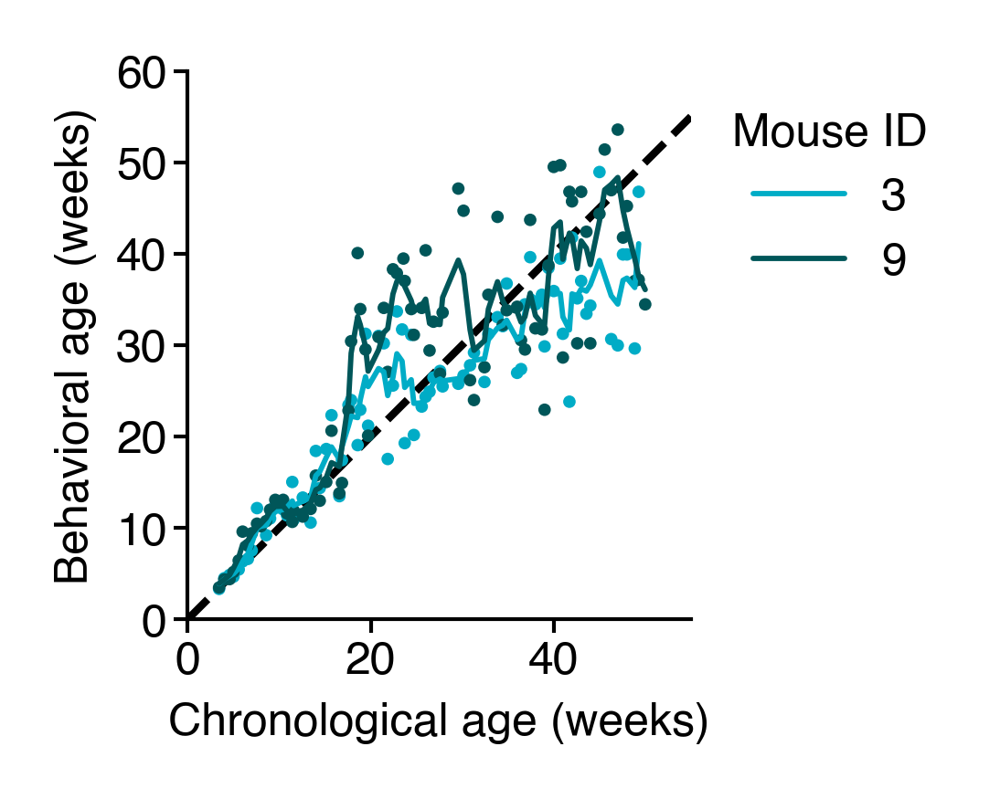

In [65]:
idx = mouse_residuals.sort_values().index
hue_order = idx[[0, -1]]
colors = [cc.glasbey[i] for i in hue_order]

fig = figure(1.5, 1.3)
ax = sns.scatterplot(
    data=female,
    x="true_ages",
    y="bio_ages",
    hue="labels",
    palette=colors,
    legend=False,
    lw=0,
    s=2.7,
    hue_order=hue_order,
)

ax = sns.lineplot(
    data=female,
    x="true_ages",
    y="smoothed_bio_age",
    hue="labels",
    palette=colors,
    legend=True,
    hue_order=hue_order,
    lw=0.7,
)

ax.set(
    aspect="equal",
    xlabel="Chronological age (weeks)",
    ylabel="Behavioral age (weeks)",
    xlim=(0, 55),
    ylim=(0, 60),
)
add_identity(ax, c="k", ls="--", zorder=-1)
legend(ax, title="Mouse ID")
sns.despine()
saver(fig, "smoothed-female-bio-age-examples-for-individuals");

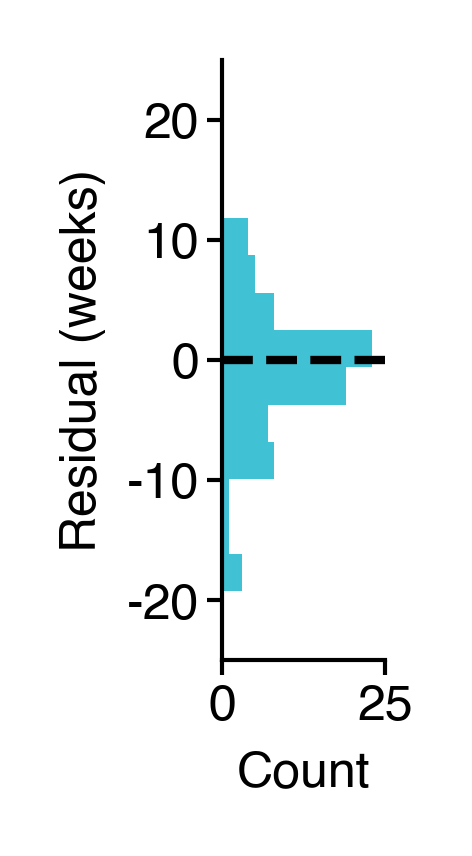

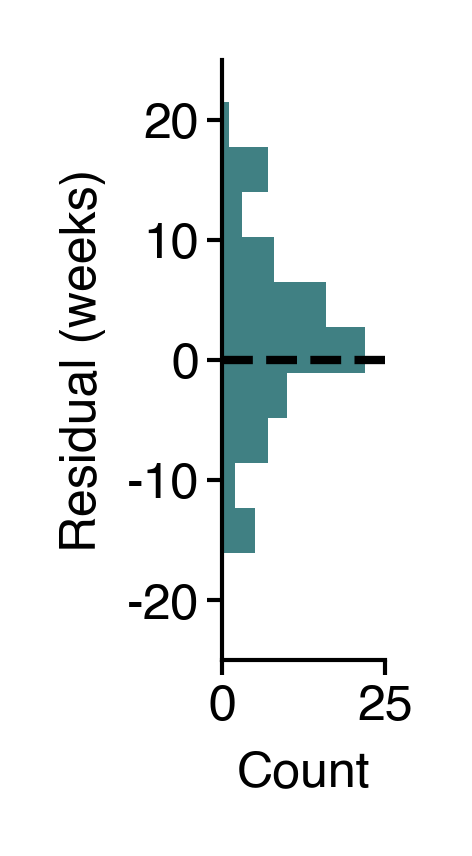

In [66]:
for mouse in idx[[0, -1]]:
    color = cc.glasbey[mouse]
    fig = figure(0.35, 1.3)
    ax = sns.histplot(y=x.query('labels == @mouse')['diff'], element='step', lw=0, bins=10, color=color)
    ax.axhline(0, color='k', ls='--')
    ax.set(ylabel="Residual (weeks)", ylim=(-25, 25), xlim=(0, 25))
    sns.despine()
    saver(fig, f"female-mouse-example-residuals-{mouse}")

## Get individual biases

In [40]:
biases = [np.array(raise_dim(p, axis=1)) for p in mdl['params']['individual_biases']]
male_biases = biases[0][sort_idx]
female_biases = biases[1][sort_idx]

In [41]:
sex_biases = np.array(raise_dim(mdl['params']['sex_biases'], axis=1))[sort_idx]
male_sex_biases = sex_biases[:, 0]
female_sex_biases = sex_biases[:, 1]

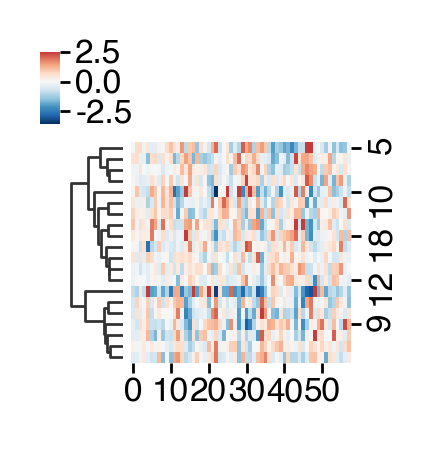

In [42]:
g = sns.clustermap(male_biases.T, cmap='RdBu_r', col_cluster=False, center=0, vmax=2.5, metric='euclidean', method='ward', figsize=(1, 1))
row_order = g.dendrogram_row.dendrogram['leaves']

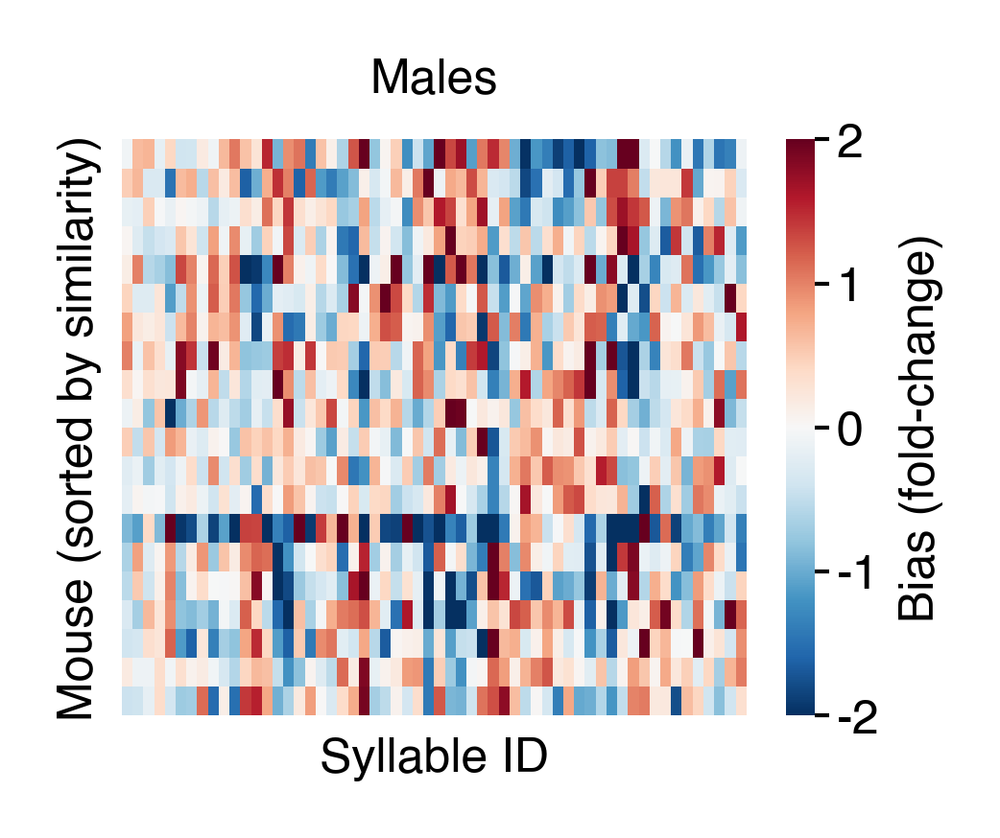

In [43]:
fig = figure(1.75, 1.3)
ax = sns.heatmap(
    male_biases.T[row_order],
    cmap="RdBu_r",
    center=0,
    vmax=2,
    vmin=-2,
    cbar_kws=dict(label="Bias (fold-change)"),
)
ax.set(
    yticks=[],
    ylabel="Mouse (sorted by similarity)",
    xlabel="Syllable ID",
    xticks=[],
    title="Males",
)
saver(fig, "long-v2-males-bias-sorted");

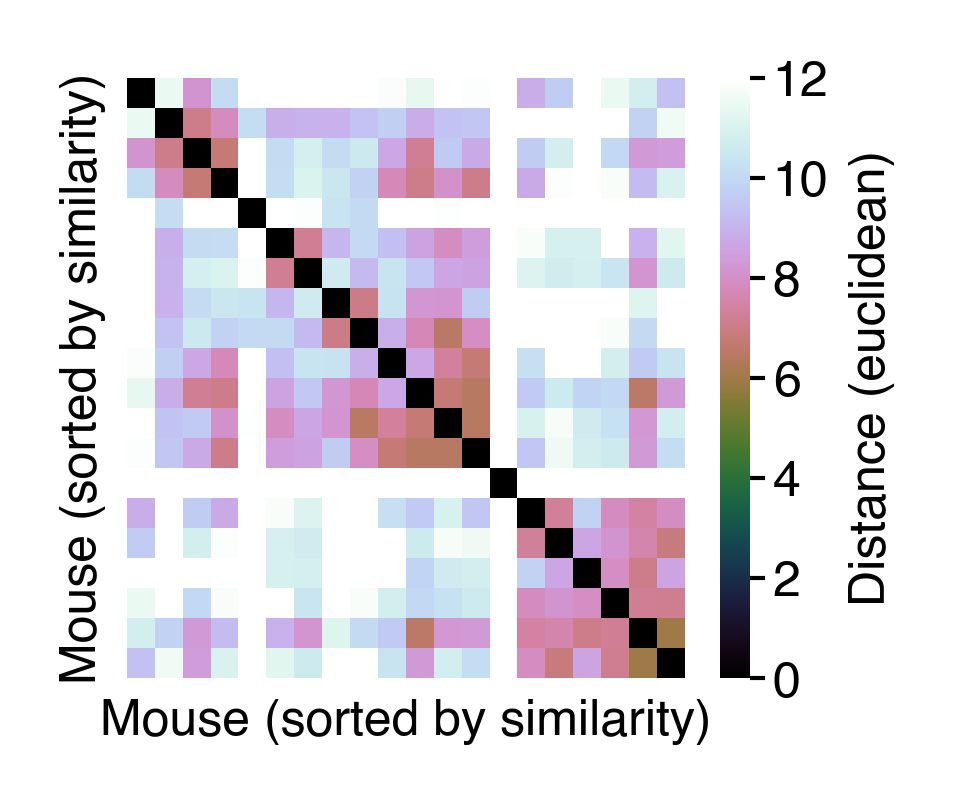

In [44]:
male_bias_dist = squareform(pdist(male_biases.T[row_order], metric='euclidean'))
fig = figure(1.5, 1.3)
ax = sns.heatmap(male_bias_dist, cmap='cubehelix', vmax=12, cbar_kws=dict(label="Distance (euclidean)"))
ax.set(xticks=[], xlabel="Mouse (sorted by similarity)", yticks=[], ylabel="Mouse (sorted by similarity)")
saver(fig, "male-bias-euc-dist-matrix");

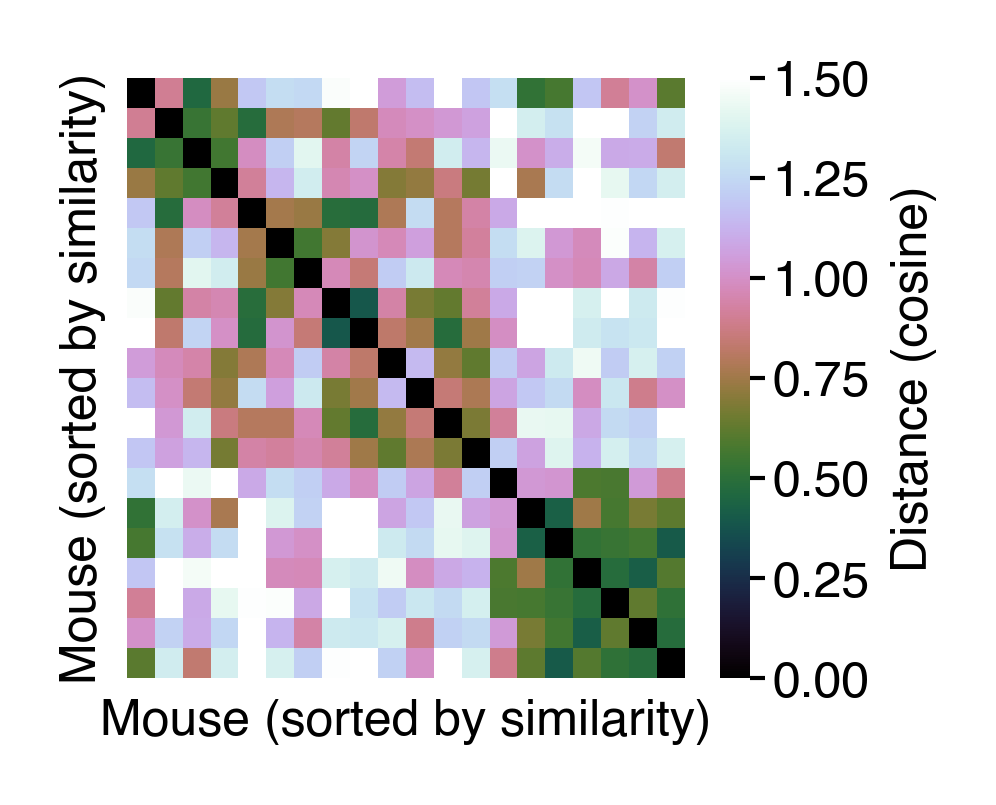

In [45]:
male_bias_dist = squareform(pdist(male_biases.T[row_order], metric='cosine'))
fig = figure(1.5, 1.3)
ax = sns.heatmap(male_bias_dist, cmap='cubehelix', vmax=1.5, cbar_kws=dict(label="Distance (cosine)"))
ax.set(xticks=[], xlabel="Mouse (sorted by similarity)", yticks=[], ylabel="Mouse (sorted by similarity)")
saver(fig, "male-bias-cos-dist-matrix");

In [46]:
# get similar and dissimilar mouse examples
male_similar = [3, 4]
male_similar = [mouse_cat[row_order[i] + 20] for i in male_similar]
male_dissimilar = mouse_cat[row_order[14] + 20]

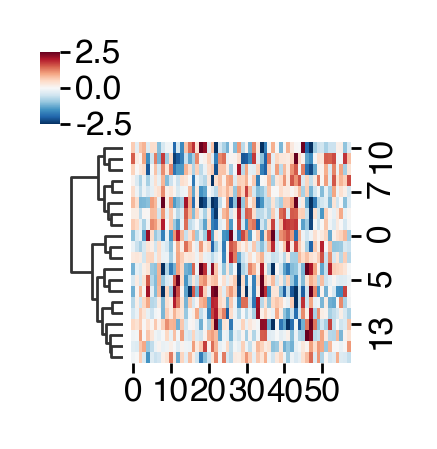

In [47]:
g = sns.clustermap(female_biases.T, cmap='RdBu_r', col_cluster=False, center=0, vmin=-2.5, vmax=2.5, metric='euclidean', method='ward', figsize=(1, 1))
row_order = g.dendrogram_row.dendrogram['leaves']

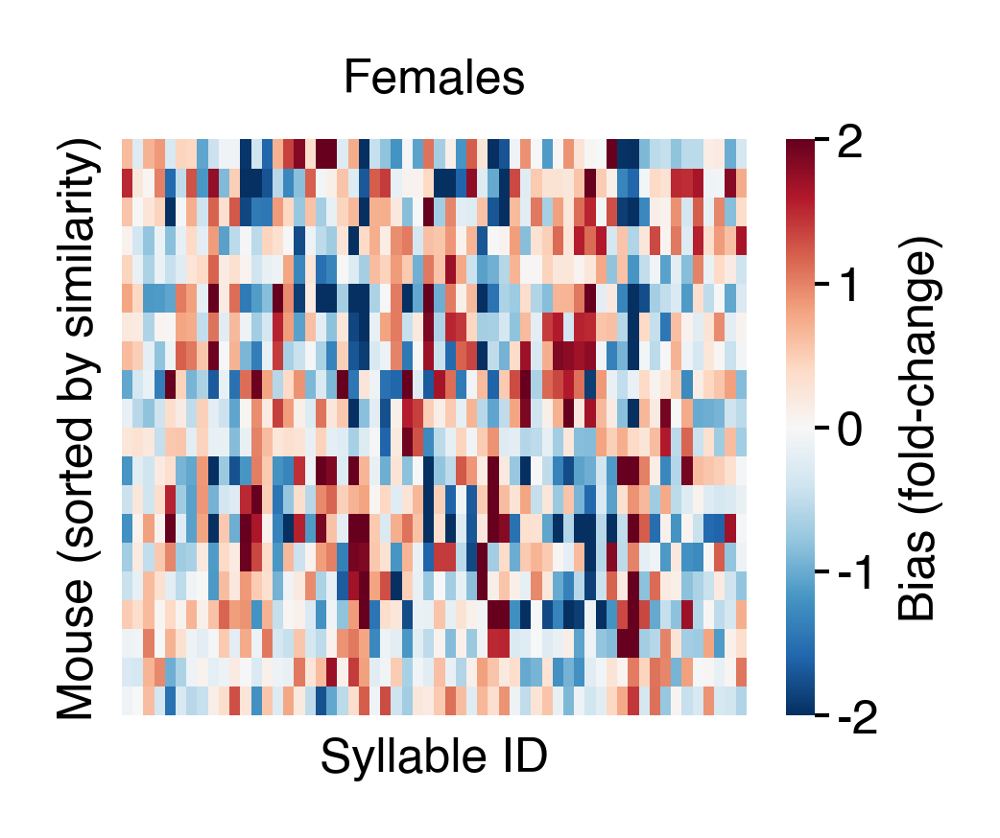

In [48]:
fig = figure(1.75, 1.3)
ax = sns.heatmap(female_biases.T[row_order], cmap='RdBu_r', center=0, vmax=2, vmin=-2, cbar_kws=dict(label="Bias (fold-change)"))
ax.set(yticks=[], ylabel="Mouse (sorted by similarity)", xlabel="Syllable ID", xticks=[], title="Females")
saver(fig, "long-v2-females-bias-sorted");

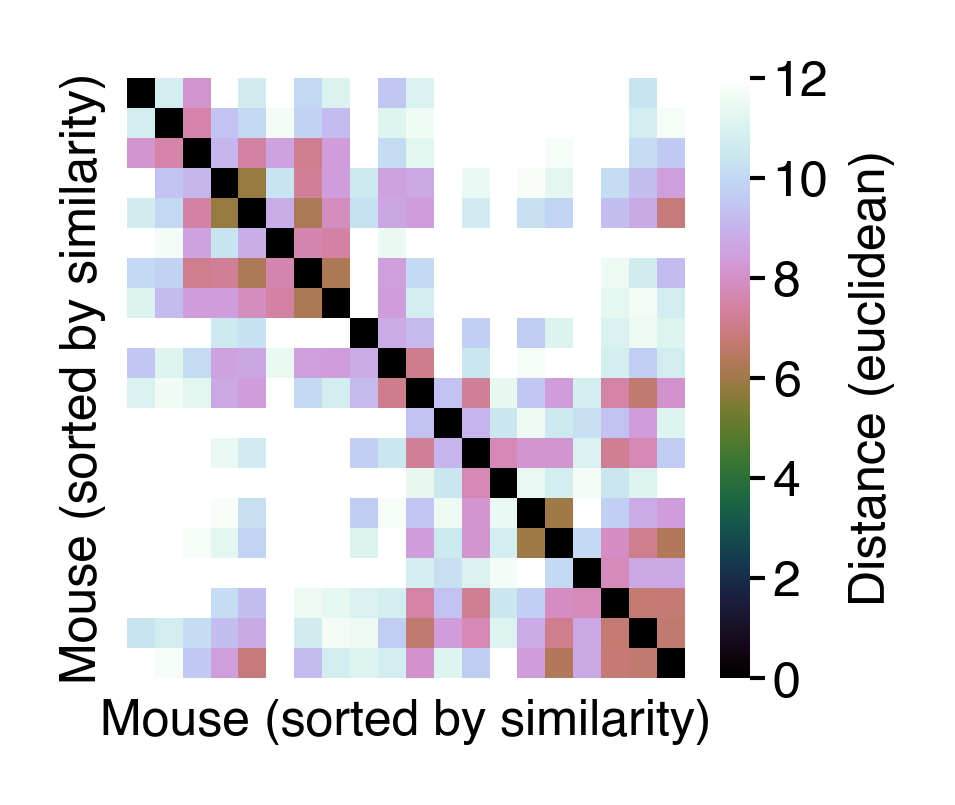

In [49]:
female_bias_dist = squareform(pdist(female_biases.T[row_order], metric='euclidean'))
fig = figure(1.5, 1.3)
ax = sns.heatmap(female_bias_dist, cmap='cubehelix', vmax=12, cbar_kws=dict(label="Distance (euclidean)"))
ax.set(xticks=[], xlabel="Mouse (sorted by similarity)", yticks=[], ylabel="Mouse (sorted by similarity)")
saver(fig, "female-bias-euc-dist-matrix");

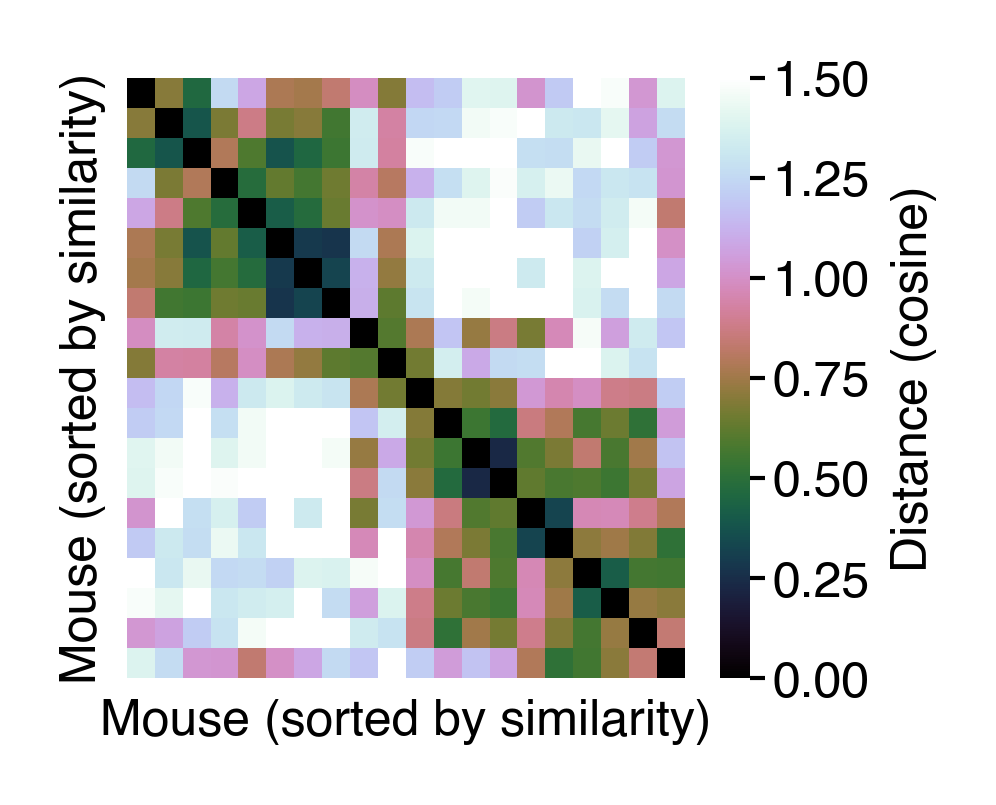

In [50]:
female_bias_dist = squareform(pdist(female_biases.T[row_order], metric='cosine'))
fig = figure(1.5, 1.3)
ax = sns.heatmap(female_bias_dist, cmap='cubehelix', vmax=1.5, cbar_kws=dict(label="Distance (cosine)"))
ax.set(xticks=[], xlabel="Mouse (sorted by similarity)", yticks=[], ylabel="Mouse (sorted by similarity)")
saver(fig, "female-bias-cos-dist-matrix");

In [51]:
# get similar and dissimilar mouse examples
# female_similar = [2, 3]
female_similar = [8, 9]
female_similar = [mouse_cat[row_order[i]] for i in female_similar]
female_dissimilar = mouse_cat[row_order[19]]

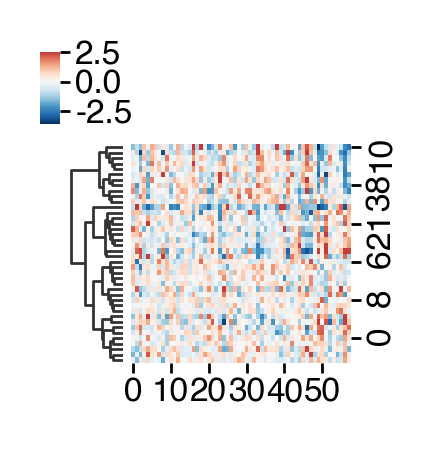

In [52]:
_biases = np.concatenate(biases, axis=1)
g = sns.clustermap(_biases.T, cmap='RdBu_r', col_cluster=False, center=0, vmax=2.5, metric='euclidean', method='ward', figsize=(1, 1))
row_order = g.dendrogram_row.dendrogram['leaves']

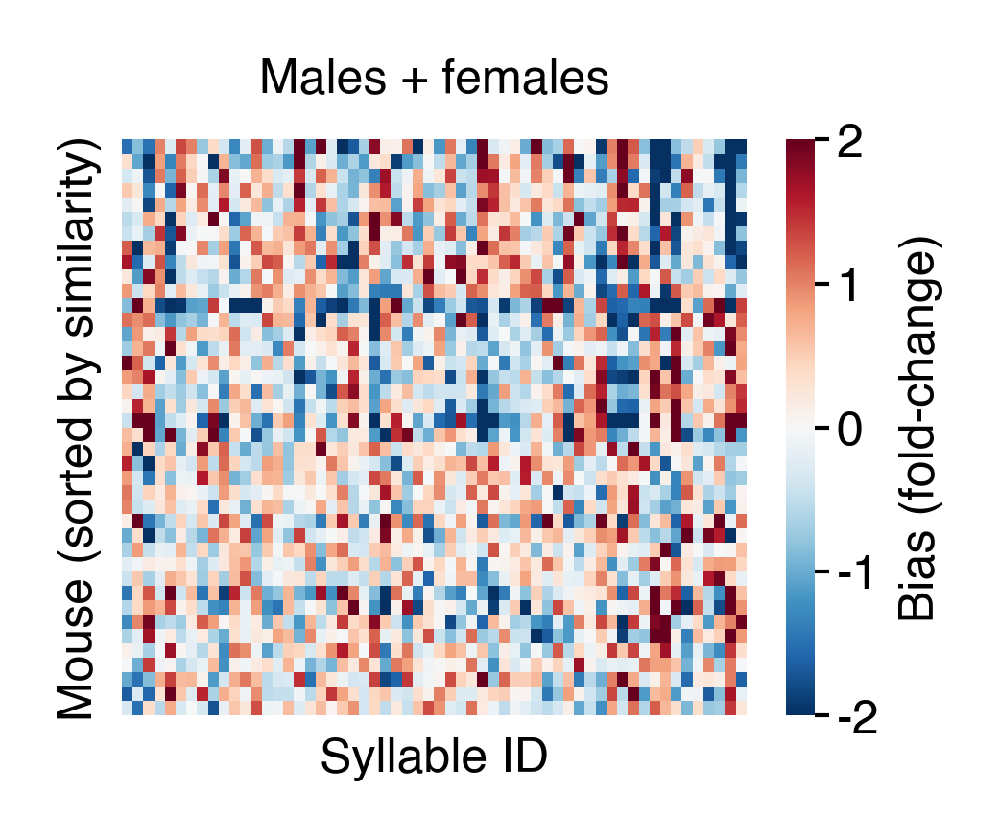

In [53]:
fig = figure(1.75, 1.3)
ax = sns.heatmap(
    _biases.T[row_order],
    cmap="RdBu_r",
    center=0,
    vmax=2,
    vmin=-2,
    cbar_kws=dict(label="Bias (fold-change)"),
)
ax.set(
    yticks=[],
    ylabel="Mouse (sorted by similarity)",
    xlabel="Syllable ID",
    xticks=[],
    title="Males + females",
)
saver(fig, "long-v2-males-females-bias-sorted");

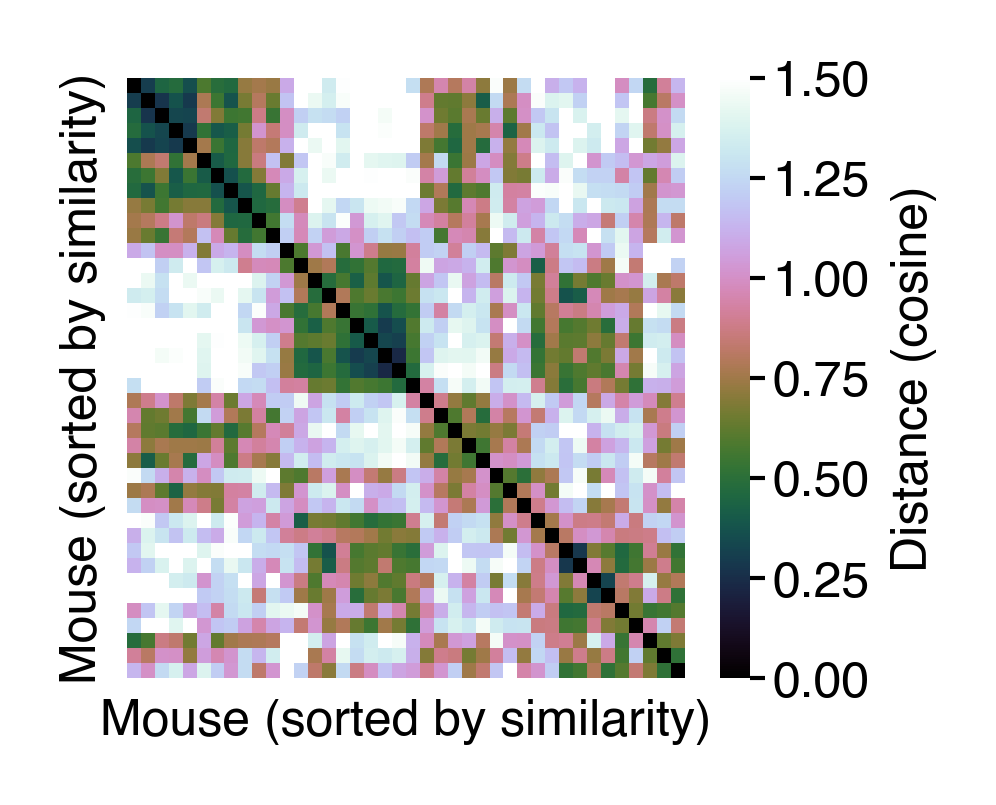

In [54]:
bias_dist = squareform(pdist(_biases.T[row_order], metric='cosine'))
fig = figure(1.5, 1.3)
ax = sns.heatmap(bias_dist, cmap='cubehelix', vmax=1.5, cbar_kws=dict(label="Distance (cosine)"))
ax.set(xticks=[], xlabel="Mouse (sorted by similarity)", yticks=[], ylabel="Mouse (sorted by similarity)")
saver(fig, "male-female-bias-cos-dist-matrix");

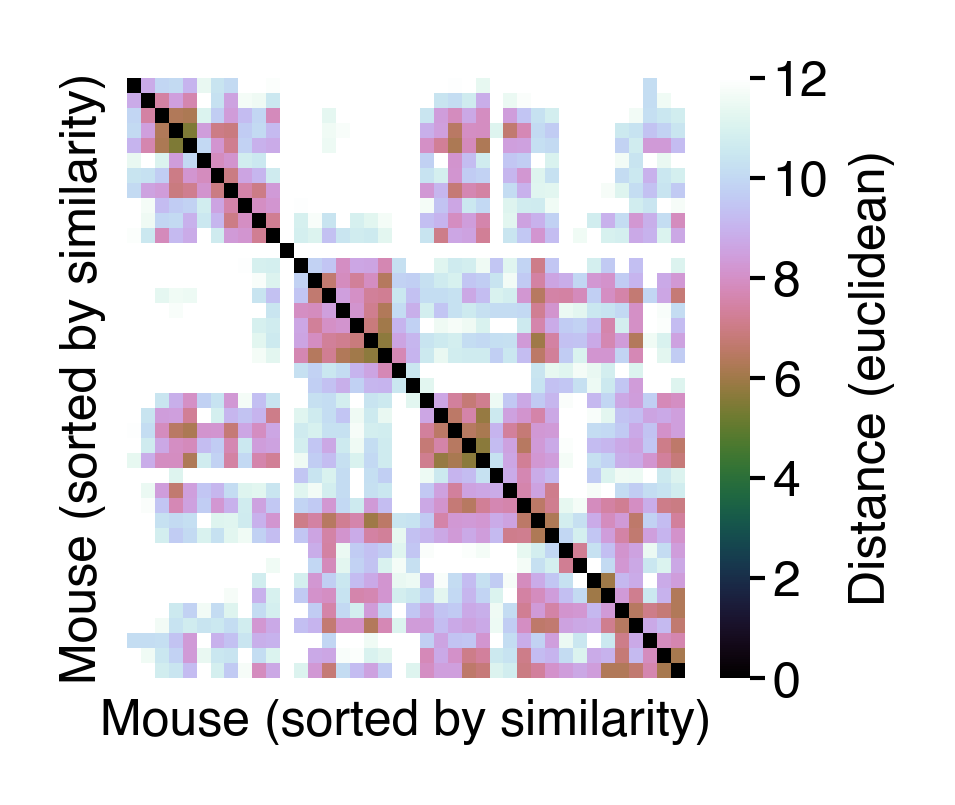

In [55]:
bias_dist = squareform(pdist(_biases.T[row_order], metric='euclidean'))
fig = figure(1.5, 1.3)
ax = sns.heatmap(bias_dist, cmap='cubehelix', vmax=12, cbar_kws=dict(label="Distance (euclidean)"))
ax.set(xticks=[], xlabel="Mouse (sorted by similarity)", yticks=[], ylabel="Mouse (sorted by similarity)")
saver(fig, "male-female-bias-euc-dist-matrix");

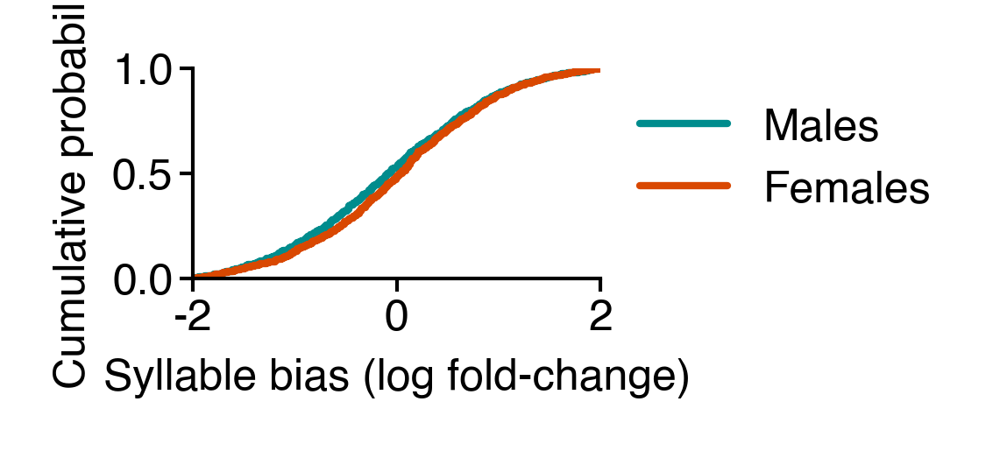

In [56]:
fig = figure(1, 0.4 * 1.3)
sns.histplot(
    (male_biases + male_sex_biases[:, None]).flatten(),
    color=COLORMAPS.ont_male(255),
    cumulative=True,
    bins=np.linspace(-2, 2, 200),
    stat="probability",
    element="step",
    fill=False,
    label="Males",
)
ax = sns.histplot(
    (female_biases + female_sex_biases[:, None]).flatten(),
    color=COLORMAPS.ont_female(255),
    cumulative=True,
    bins=np.linspace(-2, 2, 200),
    stat="probability",
    element="step",
    fill=False,
    label="Females",
)
ax.set(
    ylabel="Cumulative probability",
    xlabel="Syllable bias (log fold-change)",
    ylim=(0, 1),
    xlim=(-2, 2),
    xticks=[-2, 0, 2],
)
sns.despine()
legend()
saver(fig, "male-female-syllable-plus-sex-bias-distribution");

## PCA on model predictions

In [57]:
import umap

In [58]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import ParameterGrid, ParameterSampler
from mpl_toolkits.mplot3d import Axes3D

In [59]:
from scipy.spatial.distance import jensenshannon

In [60]:
umap_saver = save_factory(PLOT_CONFIG.save_path / "long-v2-umap-options", tight_layout=False)

In [61]:
def robust_min_max(data):
    return (data - np.quantile(data, 0.01, axis=0, keepdims=True)) / (
        np.quantile(data, 0.99, axis=0, keepdims=True)
        - np.quantile(data, 0.01, axis=0, keepdims=True)
    )

In [62]:
# NOTE: I can only do this because I concatenate males and then females
_sex = np.argmax(features["sex"], axis=0)
mm_preds = np.concatenate(
    [
        robust_min_max(mdl["predicted_counts"][_sex == 0]),
        robust_min_max(mdl["predicted_counts"][_sex == 1]),
    ]
)
mm_counts = np.concatenate(
    [robust_min_max(mdl["counts"][_sex == 0]), robust_min_max(mdl["counts"][_sex == 1])]
)

In [63]:
def make_pca(preds, counts, n_components, mdl_type="pca", **umap_params):
    if mdl_type == "pca":
        scores = PCA(n_components).fit_transform(preds)
        scores2 = PCA(n_components).fit_transform(counts)
    elif mdl_type == "umap":
        if n_components > 2:
            print(f"Warning: {n_components=} when using UMAP - setting to 2")
            n_components = 2
        # _umap = umap.UMAP(n_components=n_components, n_neighbors=80, random_state=0, min_dist=0.2, spread=0.9, metric=jensenshannon)
        _umap = umap.UMAP(**umap_params, n_components=n_components, n_jobs=1, low_memory=False)
        # fit to raw data
        scores2 = _umap.fit_transform(counts)
        # apply to predictions
        scores = _umap.transform(preds)
        # scores = _umap.fit_transform(preds)

    scores_df = pd.DataFrame(scores, index=df.index, columns=range(n_components))
    scores_df2 = pd.DataFrame(scores2, index=df.index, columns=range(n_components))

    for feat, _df in zip(("predicted", "observed"), (scores_df, scores_df2)):
        _df.columns = pd.MultiIndex.from_product([[feat]] + [range(n_components)])

    scores_df = scores_df.join(scores_df2)
    scores_df['mouse_id'] = np.argmax(features['mice'], axis=0)
    scores_df['bio_age'] = mdl['bio_ages']

    return scores_df.set_index('bio_age', append=True)


def plot_pca(scores_df, score_type='predicted', age_type='age'):
    _ages = scores_df.index.get_level_values(age_type)
    norm = plt.Normalize(vmin=_ages.min(), vmax=_ages.max())

    fig = figure(1.5, 1.5)
    for s, _df in scores_df.groupby('sex'):
        _age = _df.index.get_level_values(age_type)
        cmap = COLORMAPS.ont_female if bool(s) else COLORMAPS.ont_male
        plt.scatter(_df[(score_type, 0)], _df[(score_type, 1)], c=cmap(norm(_age)), s=4, lw=0)
    sns.despine()
    return fig


def plot_pca_with_inds(scores_df, score_type='predicted', age_type='age', cmap_type='temp', mdl_type="pca"):
    _ages = scores_df.index.get_level_values(age_type)

    fig, ax = plt.subplots(1, 2, sharex=True, sharey=True, figsize=(2.7, 1.3))
    for (s, mouse), _df in scores_df.groupby(["sex", "mouse_id"]):
        _age = _df.index.get_level_values(age_type)
        if 'temp' in cmap_type:
            cmap = cc.glasbey_warm if bool(s) else cc.glasbey_cool
        elif 'og' in cmap_type:
            cmap = cc.glasbey[:20] if bool(s) else cc.glasbey[20:40]
            mouse = mouse if bool(s) else mouse - 20
        cmap = sns.blend_palette(["w", cmap[mouse]], as_cmap=True)
        ax[s].scatter(
            _df[(score_type, 0)],
            _df[(score_type, 1)],
            c=_age,
            cmap=cmap,
            s=2.5,
            alpha=1,
            vmin=-10,
            vmax=pd.Series(_ages).quantile(0.9),
            lw=0.05,
            edgecolor='k',
        )
        if mdl_type == "pca":
            ax[s].set(xticks=[], yticks=[], xlabel="PC 1", ylabel="PC 2")
        elif mdl_type == "umap":
            ax[s].set(xticks=[], yticks=[], xlabel="Dim 1", ylabel="Dim 2")
    sns.despine()
    return fig, ax

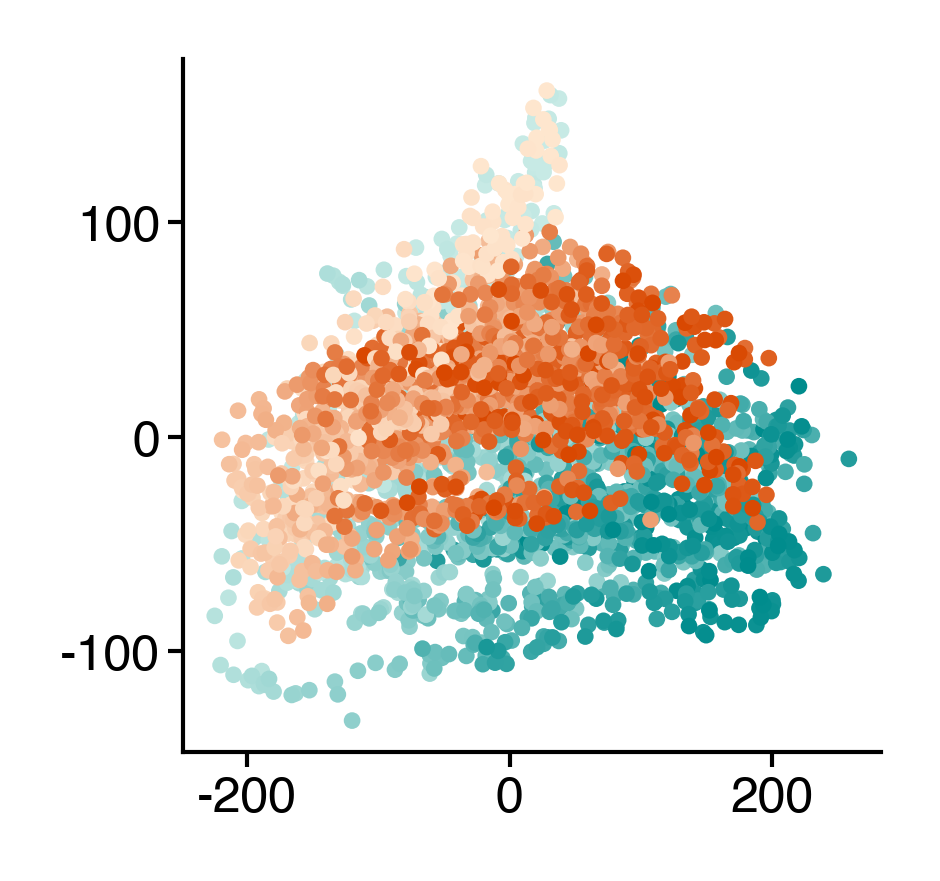

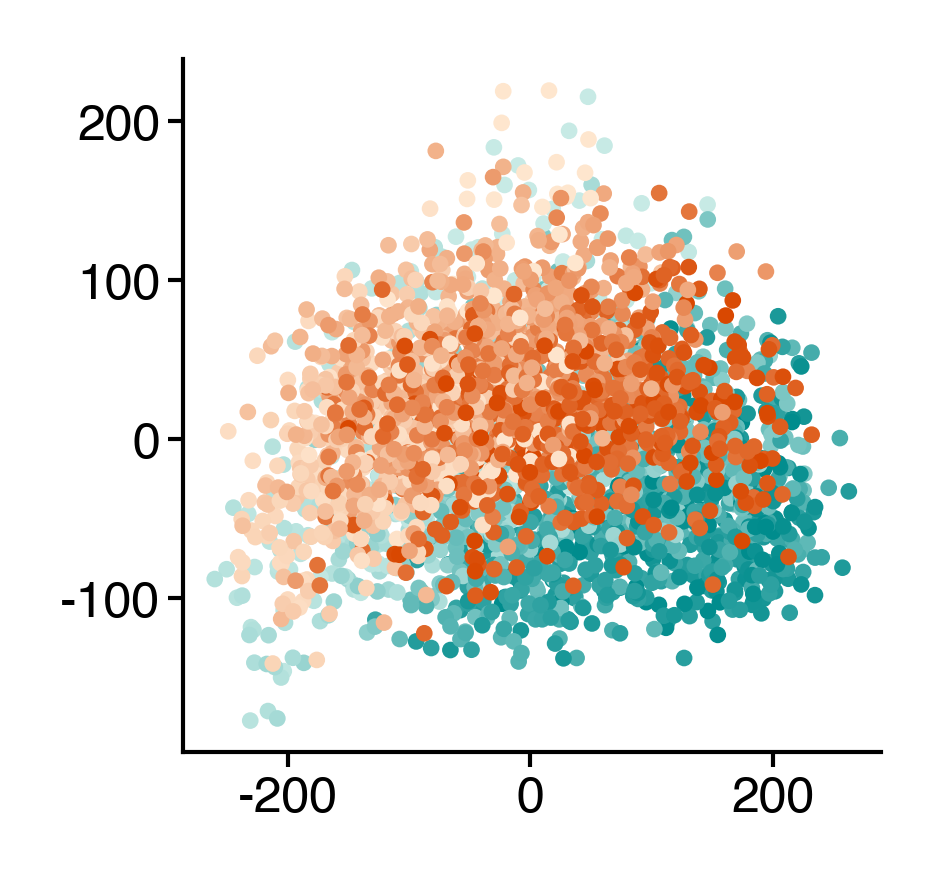

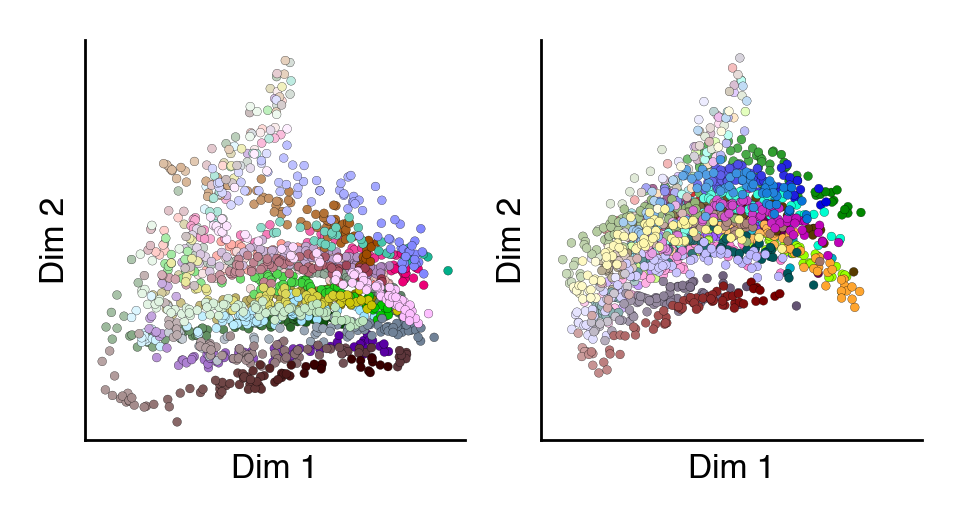

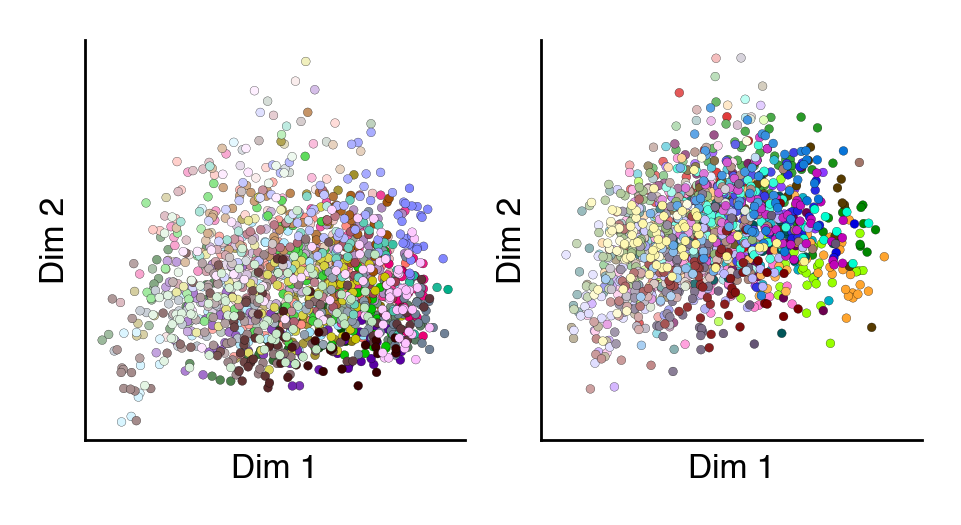

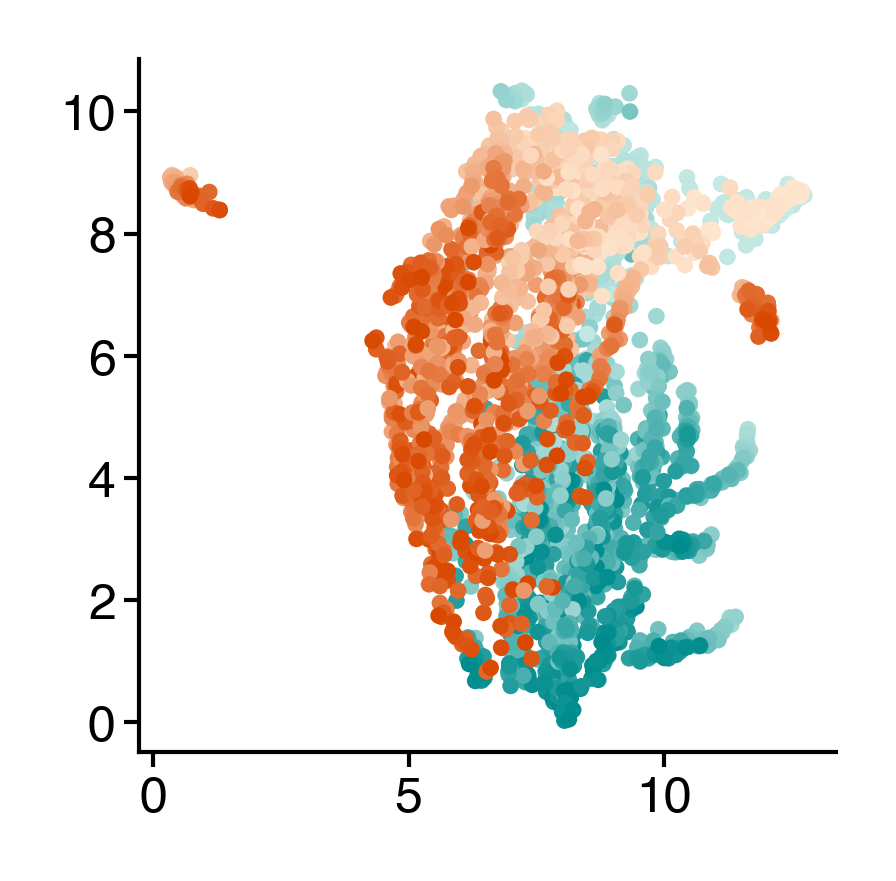

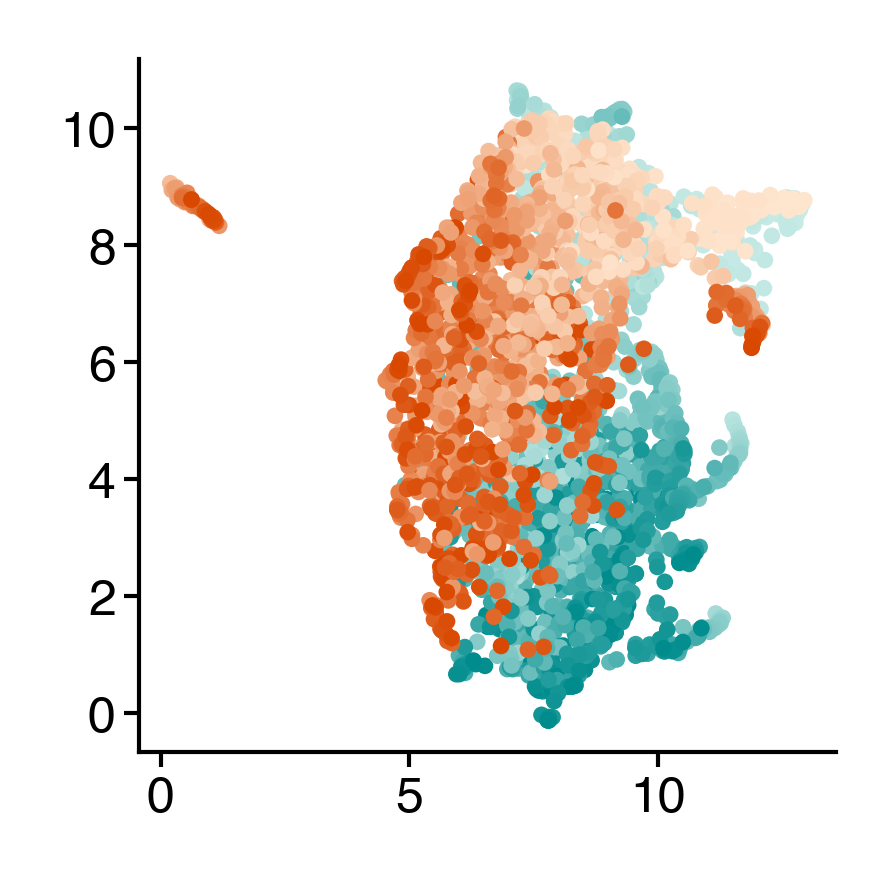

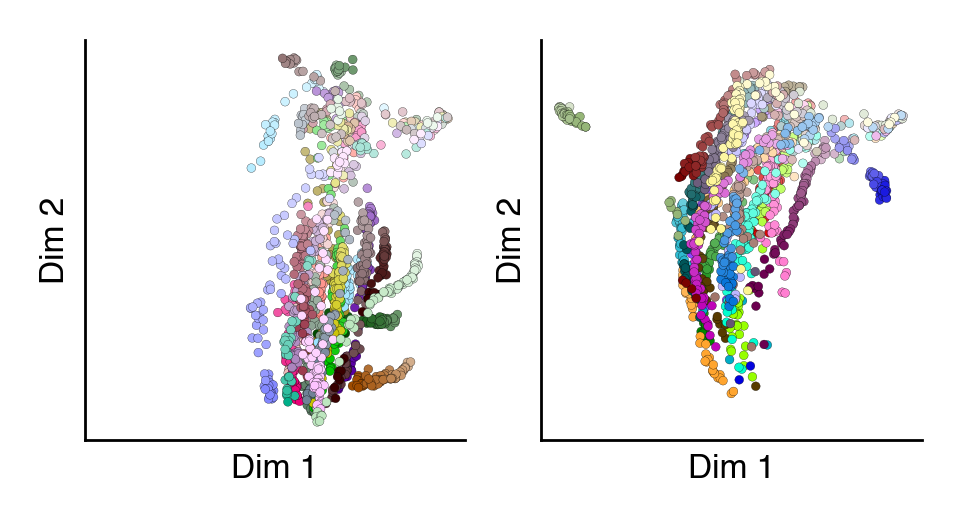

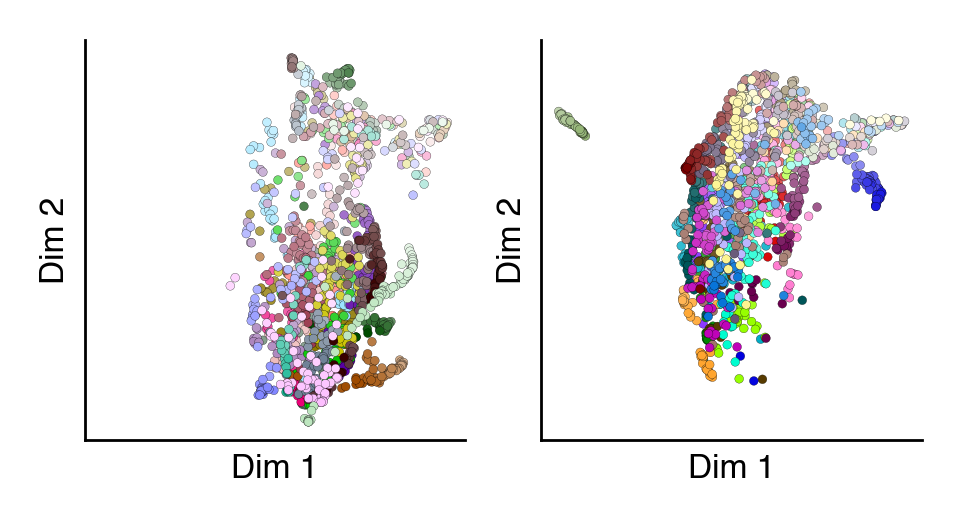

In [64]:
for mdl_type in ("pca", "umap"):
    scores_df = make_pca(mdl['predicted_counts'], mdl['counts'], 3, mdl_type=mdl_type, min_dist=0.2, metric='euclidean', n_neighbors=30,)
    # mm_scores_df = make_pca(mm_preds, mm_counts, 3, mdl_type='umap')

    fig = plot_pca(scores_df, 'predicted', 'age')

    # fig = plot_pca(scores_df, 'predicted', 'bio_age')

    fig = plot_pca(scores_df, 'observed', 'age')

    # fig = plot_pca(scores_df, 'observed', 'bio_age')

    fig, ax = plot_pca_with_inds(scores_df, "predicted", "bio_age", "og", mdl_type='umap')
    saver(fig, f"model-based-{mdl_type}-colored-by-individuals-og-coloring");

    fig, ax = plot_pca_with_inds(scores_df, "observed", "bio_age", 'og', mdl_type='umap')
    saver(fig, f"og-{mdl_type}-colored-by-individuals-og-coloring");

    # plot_pca_with_inds(scores_df, "predicted", "age", mdl_type='umap');
    # plot_pca_with_inds(scores_df, "observed", "age", mdl_type='umap');

    # fig, ax = plot_pca_with_inds(scores_df, "predicted", "bio_age", mdl_type='umap')
    # saver(fig, f"model-based-{mdl_type}-colored-by-individuals");

    # fig, ax = plot_pca_with_inds(scores_df, "observed", "bio_age", mdl_type='umap')
    # saver(fig, f"og-{mdl_type}-colored-by-individuals");

In [65]:
def plot_pca_with_traj(scores_df, male_idx, female_idx, score_type="predicted", n_cuts=11):
    age_type = "age"

    def plot_individual(df, idx, mouse_idx, sex, label, ax):
        mouse_df = df.loc[pd.IndexSlice[:, mouse_idx], :].reset_index(level=list(set([age_type, "bio_age"])))
        bio_age = mouse_df["bio_age"]
        avg = mouse_df.groupby(pd.cut(bio_age, n_cuts, labels=False)).mean()
        id_norm = plt.Normalize(
            vmin=avg["bio_age"].min() - 10, vmax=avg["bio_age"].max()
        )
        _cmap = cc.glasbey_cool if sex == 0 else cc.glasbey_warm
        id_cmap = sns.blend_palette(["white", _cmap[idx]], as_cmap=True)

        ax.plot(avg[(score_type, 0)], avg[(score_type, 1)], color="k", lw=1.75)
        for j, x in enumerate(drop(1, avg.sort_index(ascending=False).rolling(2))):
            ax.plot(
                x[(score_type, 0)],
                x[(score_type, 1)],
                color=id_cmap(id_norm(x.iloc[0]["bio_age"])),
                lw=1.2,
                label=label if j == 0 else None,
            )

    fig, ax = plt.subplots(1, 2, sharex=True, sharey=True, figsize=(3.7, 1.3), gridspec_kw={'wspace': 0.7})

    _ages = scores_df.index.get_level_values(age_type)
    norm = plt.Normalize(vmin=_ages.min(), vmax=_ages.max())

    for (s, _df), a in zip(scores_df.groupby("sex"), ax.flat):
        _age = _df.index.get_level_values(age_type)
        cmap = COLORMAPS.ont_female if bool(s) else COLORMAPS.ont_male
        a.scatter(
            _df[(score_type, 0)],
            _df[(score_type, 1)],
            c=cmap(norm(_age)),
            alpha=0.7,
            lw=0,
            s=3,
        )
        if s == 0:
            # males
            similar = male_idx[:-1]
            dissimilar = male_idx[-1]
        else:
            similar = female_idx[:-1]
            dissimilar = female_idx[-1]
        for i, m in enumerate(similar):
            plot_individual(_df, i, m, s, "Similar", a)

        plot_individual(_df, i + 5, dissimilar, s, "Dissimilar", a)
        a.set(
            xlabel="PC 1",
            ylabel="PC 2",
            title="Females" if bool(s) else "Males",
            xticks=[],
            yticks=[],
        )
        legend(a)
    sns.despine()
    return fig, ax

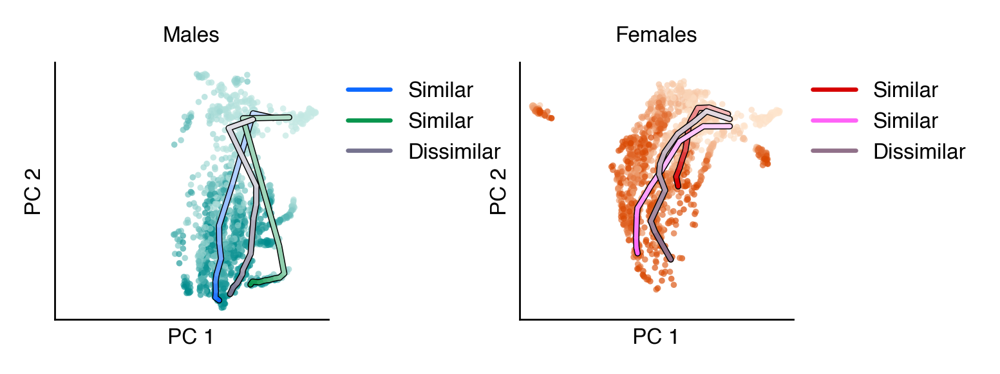

In [66]:
fig, ax = plot_pca_with_traj(
    scores_df,
    male_similar + [male_dissimilar],
    female_similar + [female_dissimilar],
    "predicted",
    n_cuts=11,
)
saver(fig, "model-based-pca-with-animal-trajectories");

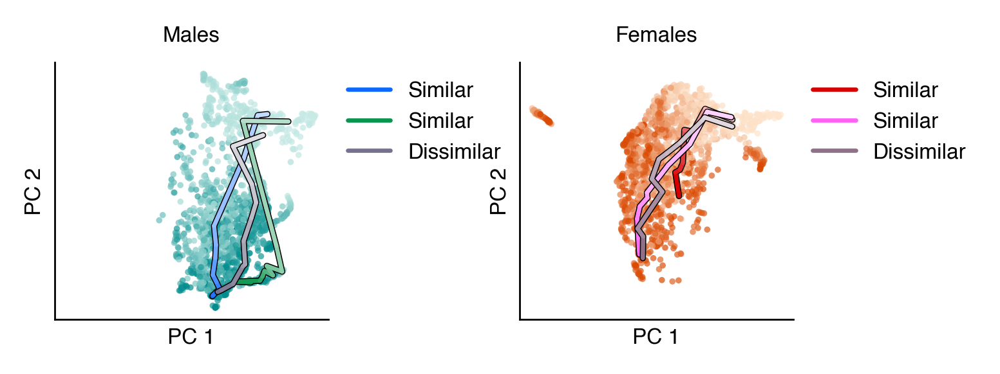

In [67]:
fig, ax = plot_pca_with_traj(
    scores_df,
    male_similar + [male_dissimilar],
    female_similar + [female_dissimilar],
    "observed",
    n_cuts=11,
)
saver(fig, "og-pca-with-animal-trajectories");

## Relative contributions

### New version

In [68]:
mdl_params = mdl['params']
mdl_components = mdl['init_components']
indiv_bias_scale = np.exp(mdl_params['development_weights'] @ mdl_components.bases['development'])
sex_bias_scale = np.exp(mdl_params['sex_weights'] @ mdl_components.bases['sex'])
list(mdl_params)

['bio_basis_weights',
 'development_weights',
 'individual_biases',
 'sex_biases',
 'sex_weights',
 'size_slope']

### Size

In [69]:
size_effect = np.abs(mdl_params['size_slope'].squeeze())

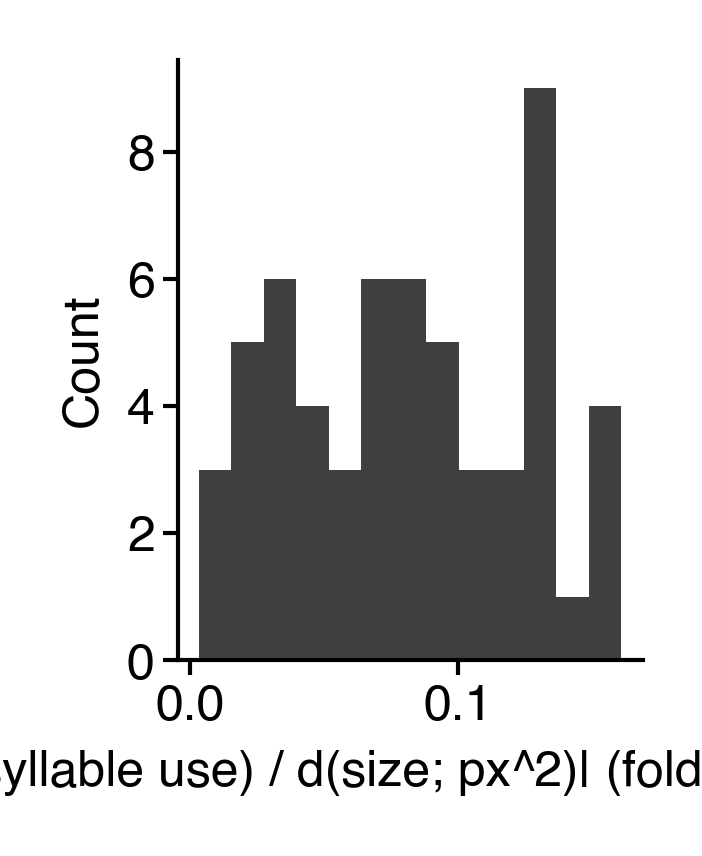

In [70]:
# size plot - histogram of slopes across syllables
fig = figure(1, 1.3)

ax = sns.histplot(size_effect, bins=13, element='step', fill=True, linewidth=0, color="k")
ax.set(xlabel="|d(syllable use) / d(size; px^2)| (fold-change)")
sns.despine()
saver(fig, "size-deriv-histogram");

### Age

In [71]:
splines = mdl_params['bio_basis_weights'] @ mdl_components.bases['bio']

bio_deriv = np.diff(splines, axis=1)

true_age = mdl_components.age_unnormalizer(mdl_components.age_samples)
age_diff = np.diff(true_age)

bio_deriv_norm = bio_deriv / age_diff[None]

In [72]:
deriv_df = pd.DataFrame(bio_deriv_norm.T, columns=pd.Index(df.columns, name="syllable"), index=pd.Index(true_age[:-1], name="age")).abs()
melt_deriv_df = deriv_df.reset_index().melt(id_vars='age').query('age < 100 & age > 4')

/tmp/ipykernel_26068/120874008.py:2: UserWarning: 
The palette list has fewer values (1) than needed (58) and will cycle, which may produce an uninterpretable plot.
  ax = sns.lineplot(


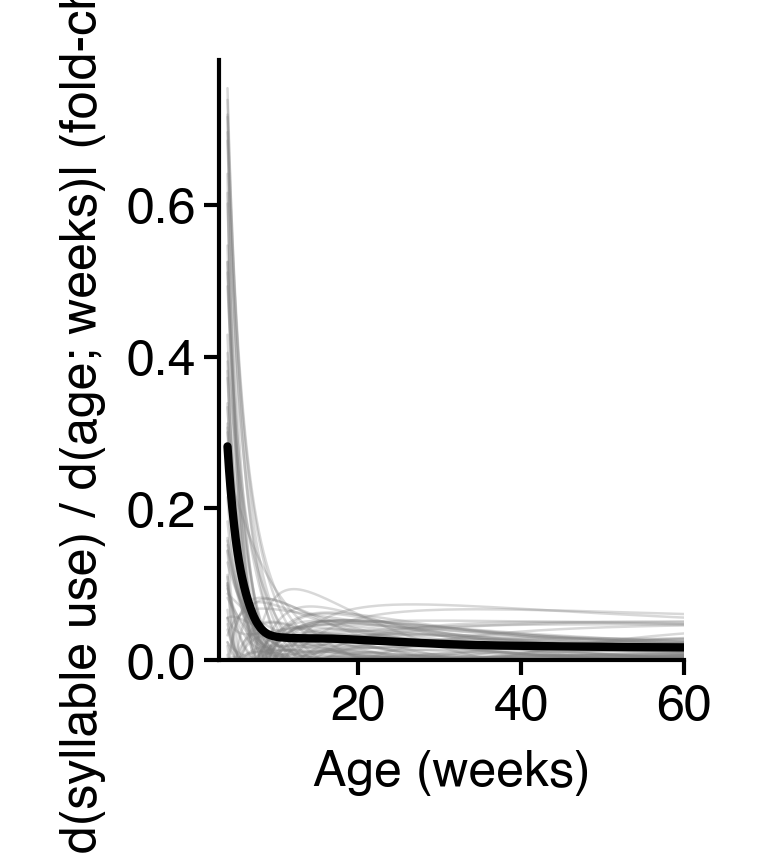

In [73]:
fig = figure(1, 1.3)
ax = sns.lineplot(
    data=melt_deriv_df,
    x="age",
    y="value",
    hue="syllable",
    errorbar=None,
    err_kws=dict(lw=0),
    palette=["gray"],
    legend=False,
    linewidth=0.3,
    alpha=0.3,
)
ax = sns.lineplot(
    data=melt_deriv_df,
    x="age",
    y="value",
    errorbar=None,
    err_kws=dict(lw=0),
    color='k',
    legend=False,
    linewidth=1,
    alpha=1,
    ax=ax
)
ax.set(
    xlabel="Age (weeks)",
    ylabel="|d(syllable use) / d(age; weeks)| (fold-change)",
    xlim=(3, 60),
    ylim=(0, None),
)
sns.despine()
saver(fig, "age-deriv-lineplot");

### Sex

In [74]:
sex_bias = np.array(raise_dim(mdl_params['sex_biases'], axis=1))
sex_bias_effect = np.mean(np.abs(sex_bias), axis=1).squeeze()
sex_bias_effect_w_scaling = (sex_bias_scale * sex_bias_effect[:, None])

In [75]:
sex_deriv_df = pd.DataFrame(
    sex_bias_effect_w_scaling.T,
    columns=pd.Index(df.columns, name="syllable"),
    index=pd.Index(true_age, name="age"),
).abs()
melt_sex_deriv_df = (
    sex_deriv_df.reset_index().melt(id_vars="age").query("age < 60 & age > 4")
)

/tmp/ipykernel_26068/2088527583.py:2: UserWarning: 
The palette list has fewer values (1) than needed (58) and will cycle, which may produce an uninterpretable plot.
  ax = sns.lineplot(


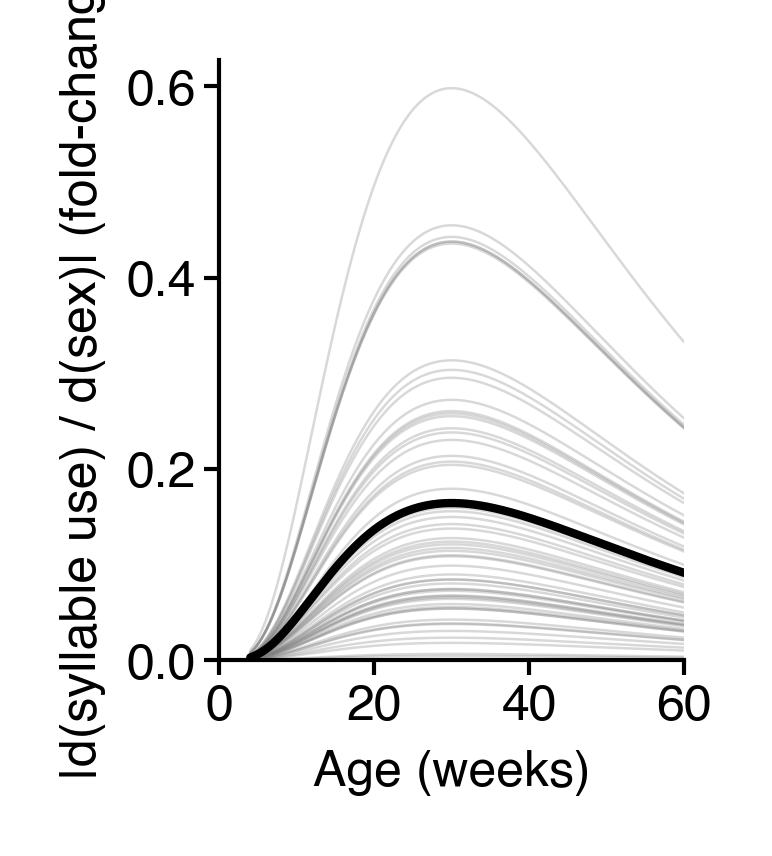

In [76]:
fig = figure(1, 1.3)
ax = sns.lineplot(
    data=melt_sex_deriv_df,
    x="age",
    y="value",
    hue="syllable",
    errorbar=None,
    err_kws=dict(lw=0),
    palette=["gray"],
    legend=False,
    linewidth=0.3,
    alpha=0.3,
)
ax = sns.lineplot(
    data=melt_sex_deriv_df,
    x="age",
    y="value",
    errorbar=None,
    err_kws=dict(lw=0),
    color='k',
    legend=False,
    linewidth=1,
    alpha=1,
    ax=ax,
)
ax.set(
    xlabel="Age (weeks)",
    ylabel="|d(syllable use) / d(sex)| (fold-change)",
    xlim=(0, 60),
    ylim=(0, None),
)
sns.despine()
saver(fig, "sex-deriv-lineplot");

### Individuality

In [77]:
from scipy.spatial.distance import pdist

In [78]:
indiv_bias = np.concatenate([raise_dim(x, axis=1) for x in mdl_params['individual_biases']], axis=1)
# indiv_bias_effect = np.array([np.mean(pdist(indiv_bias[[i]].T)) for i in range(len(indiv_bias))])
indiv_bias_effect = np.mean(np.abs(indiv_bias), axis=1)
indiv_bias_effect_w_scaling = (indiv_bias_scale * indiv_bias_effect[:, None])

In [79]:
indiv_deriv_df = pd.DataFrame(
    indiv_bias_effect_w_scaling.T,
    columns=pd.Index(df.columns, name="syllable"),
    index=pd.Index(true_age, name="age"),
).abs()
melt_indiv_deriv_df = (
    indiv_deriv_df.reset_index().melt(id_vars="age").query("age < 60 & age > 4")
)

/tmp/ipykernel_26068/1580796327.py:2: UserWarning: 
The palette list has fewer values (1) than needed (58) and will cycle, which may produce an uninterpretable plot.
  ax = sns.lineplot(


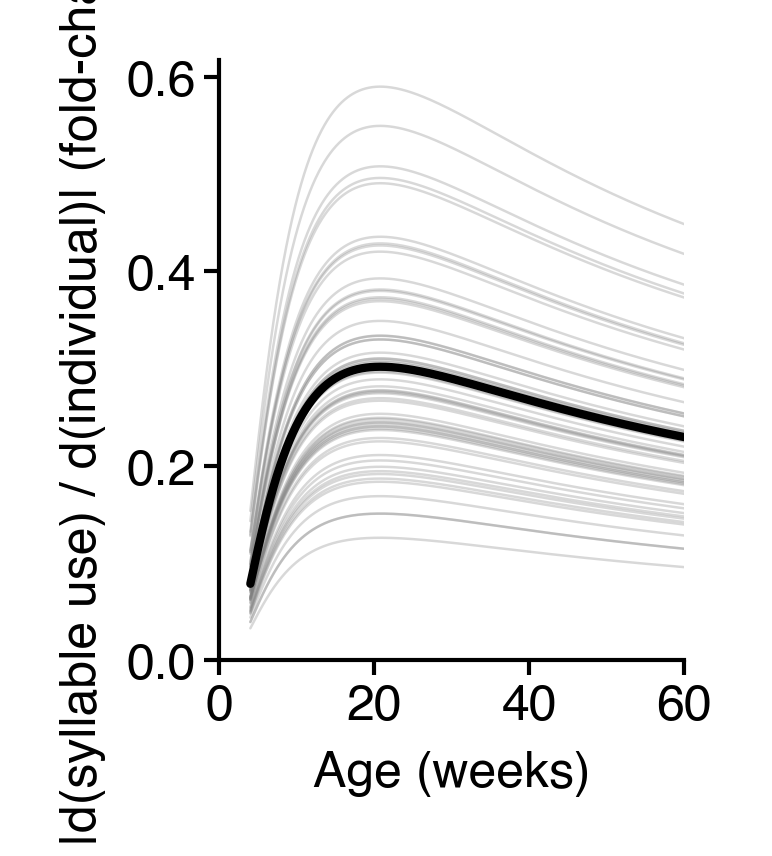

In [80]:
fig = figure(1, 1.3)
ax = sns.lineplot(
    data=melt_indiv_deriv_df,
    x="age",
    y="value",
    hue="syllable",
    errorbar=None,
    err_kws=dict(lw=0),
    palette=["gray"],
    legend=False,
    linewidth=0.3,
    alpha=0.3,
)
ax = sns.lineplot(
    data=melt_indiv_deriv_df,
    x="age",
    y="value",
    errorbar=None,
    err_kws=dict(lw=0),
    color='k',
    legend=False,
    linewidth=1,
    alpha=1,
    ax=ax,
)
ax.set(
    xlabel="Age (weeks)",
    ylabel="|d(syllable use) / d(individual)| (fold-change)",
    xlim=(0, 60),
    ylim=(0, None),
)
sns.despine()
saver(fig, "indiv-deriv-lineplot");

### Rank-order each syllable + effect

In [81]:
sex_rank = np.argsort(np.argsort(sex_deriv_df.mean().values))
indiv_rank = np.argsort(np.argsort(indiv_deriv_df.mean().values))
size_rank = np.argsort(np.argsort(size_effect))
age_rank = np.argsort(np.argsort(deriv_df.mean().values))

In [82]:
rank_df = pd.DataFrame(dict(sex=sex_rank, size=size_rank, age=age_rank, individuality=indiv_rank), index=pd.Index(range(len(sex_rank)), name="syll_idx"))

In [83]:
melt_rank_df = rank_df.reset_index().melt(id_vars='syll_idx')

In [84]:
age_rank_map = rank_df['age']

In [85]:
melt_rank_df['age_rank_map'] = melt_rank_df['syll_idx'].map(age_rank_map)

/tmp/ipykernel_26068/4127790683.py:3: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set(ylabel="Syllable rank", xlabel="Factor", xticklabels=["Age", "Sex", "Size", "Individuality"])


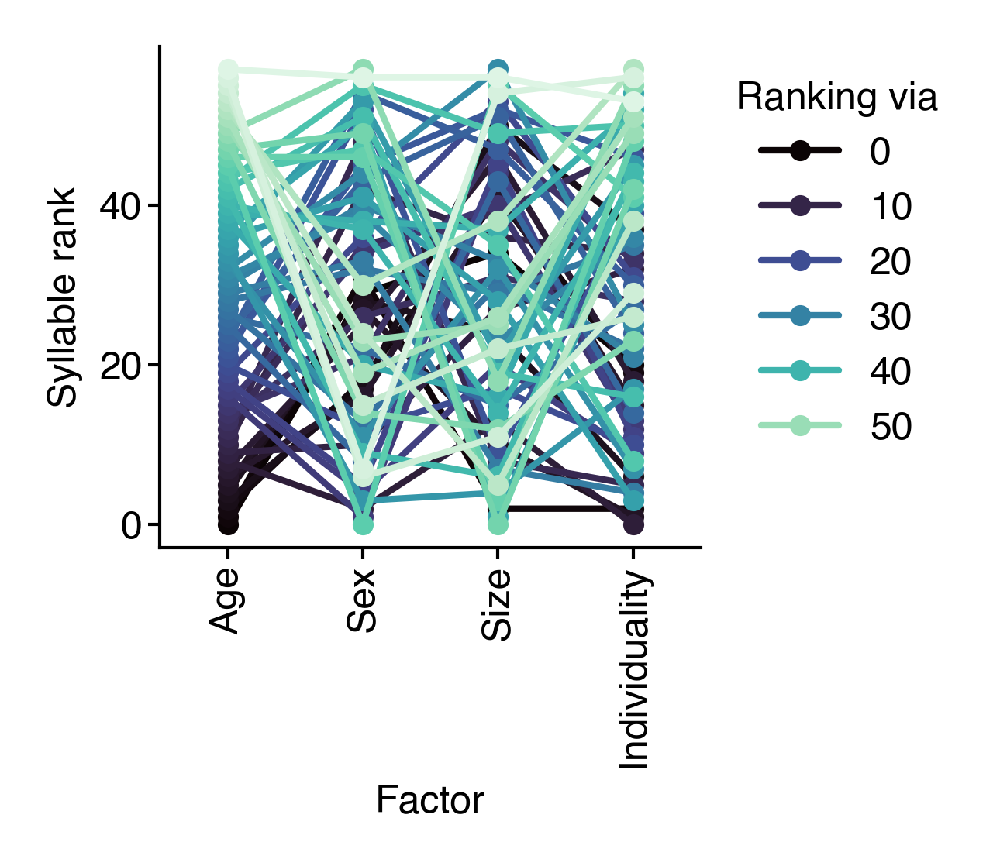

In [86]:
fig = figure(1.5, 1.4)
ax = sns.pointplot(data=melt_rank_df, x='variable', y='value', hue='age_rank_map', order=['age', 'sex', 'size', 'individuality'], palette='mako', linewidth=1)
ax.set(ylabel="Syllable rank", xlabel="Factor", xticklabels=["Age", "Sex", "Size", "Individuality"])
legend(ax, title="Ranking via")
ax.tick_params(axis='x', rotation=90)
sns.despine()
saver(fig, "bambi-factor-syllable-derivative-ranking");

## Make plots showing high-influence syllables are better predicting than low-influence syllables

In [87]:
from sklearn.svm import SVC, SVR
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression, ElasticNet
from sklearn.cross_decomposition import PLSRegression
from sklearn.model_selection import cross_val_predict, KFold
from sklearn.metrics import accuracy_score, r2_score

In [88]:
clf_data = df.reset_index().assign(bio_age=mdl['bio_ages'])

In [89]:
melt_rank_df = rank_df.reset_index().melt(id_vars='syll_idx')

In [90]:
syll_factors = rank_df.idxmax(1)

In [91]:
grp_ranks = {}
for grp, ser in syll_factors.groupby(syll_factors):
    grp_ranks[grp] = rank_df.loc[ser.index, grp].sort_values(ascending=False)

In [92]:
valmap(len, grp_ranks)

{'age': 11, 'individuality': 10, 'sex': 18, 'size': 19}

In [93]:
top_n = 10
filt_sylls = {k: v.index[:top_n] for k, v in grp_ranks.items()}

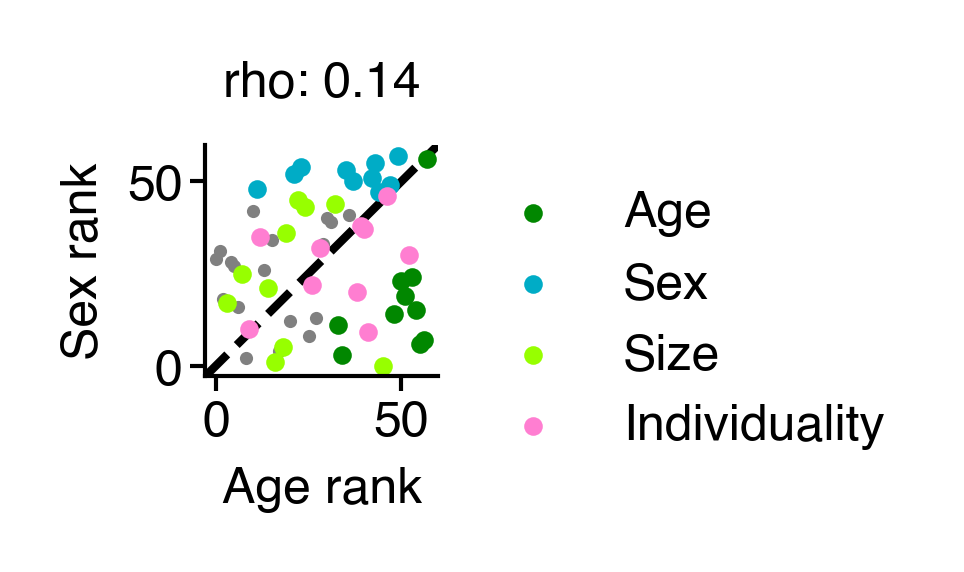

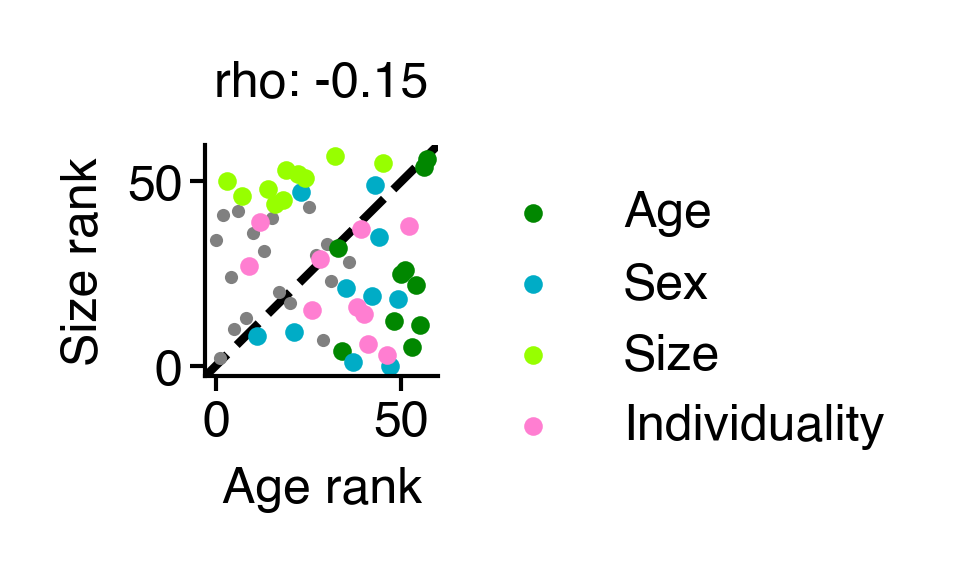

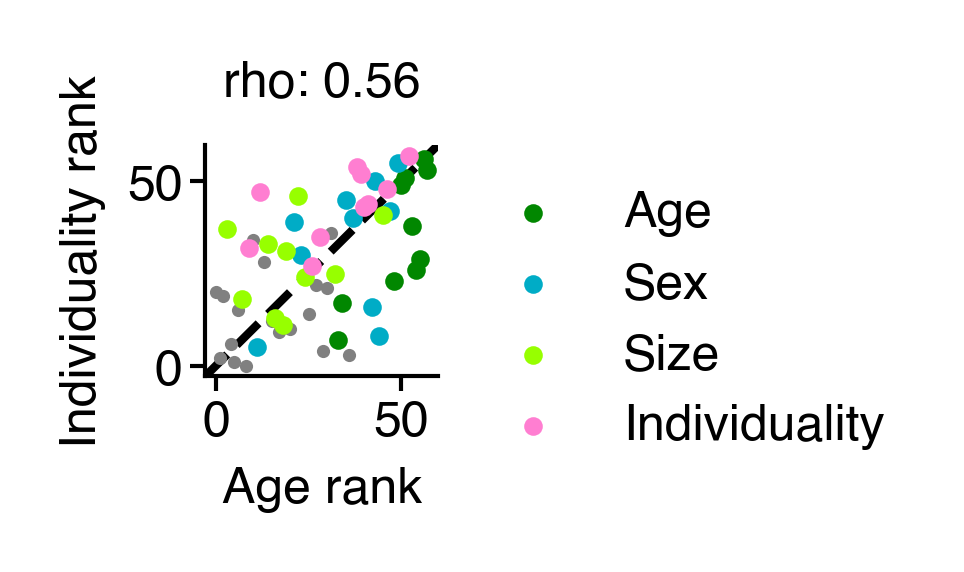

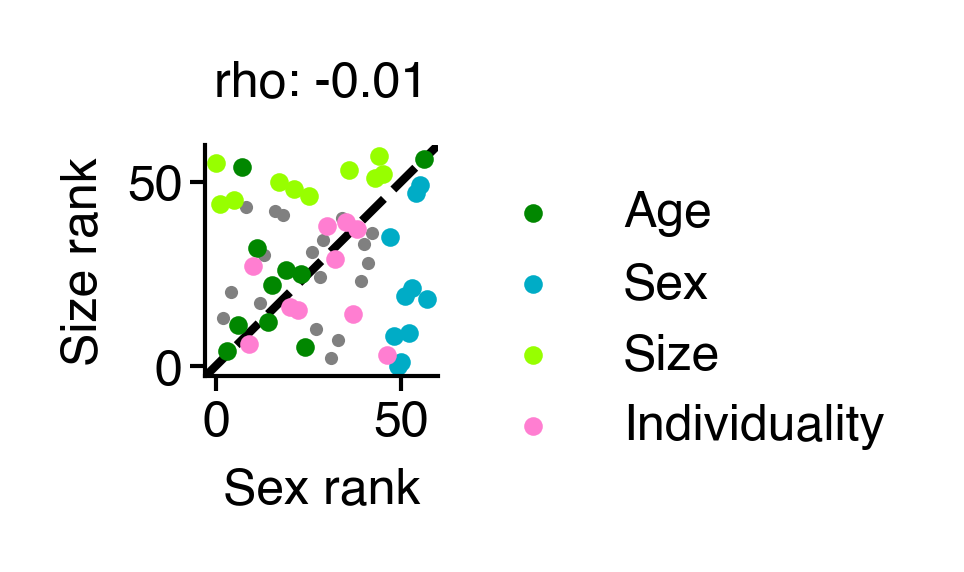

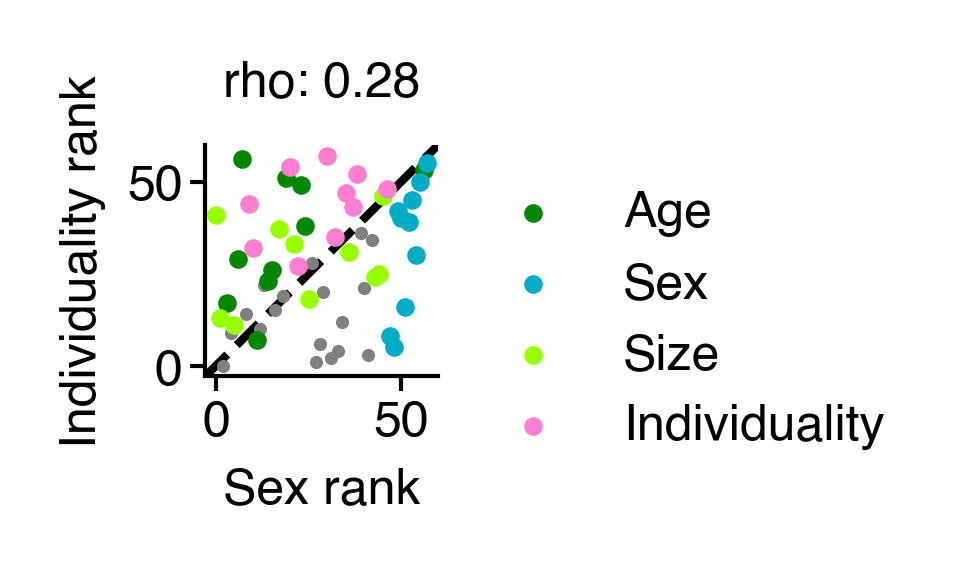

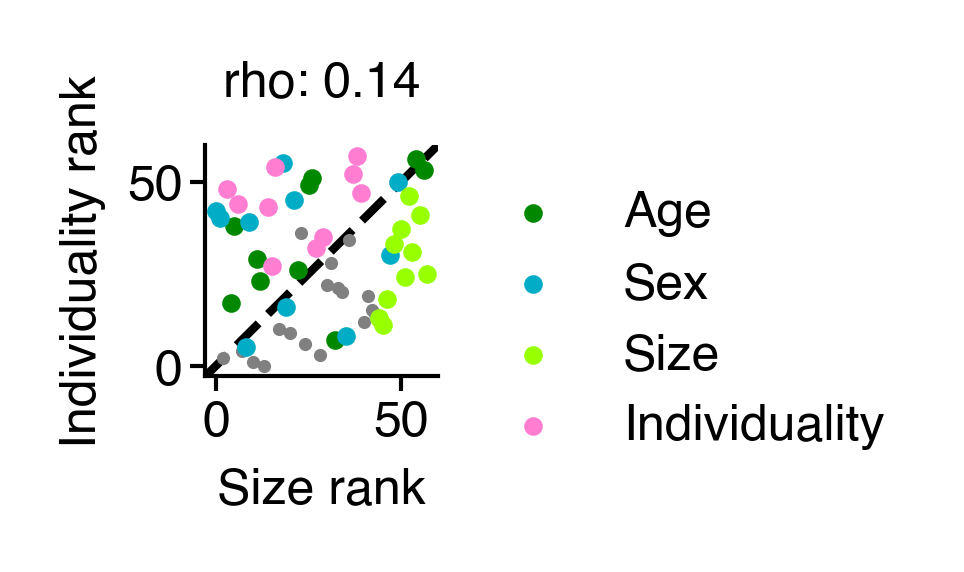

In [94]:
colors = dict(zip(['age', 'sex', 'size', 'individuality'], cc.glasbey[2:]))

for t1, t2 in combinations(['age', 'sex', 'size', 'individuality'], 2):
    fig = figure(0.5, 0.5)
    ax = fig.gca()
    c = rank_df[t1].corr(rank_df[t2], method='spearman')
    ax.scatter(rank_df[t1], rank_df[t2], s=2.5, linewidth=0, color='gray')
    for _factor, _color in colors.items():
        ax.scatter(rank_df.loc[filt_sylls[_factor], t1], rank_df.loc[filt_sylls[_factor], t2], s=5, linewidth=0, color=colors[_factor], label=_factor.capitalize())
    add_identity(ax, ls='--', color='k', zorder=-1)
    legend(ax)
    ax.set(xlabel=f"{t1.capitalize()} rank", ylabel=f"{t2.capitalize()} rank", title=f"rho: {c:0.2f}")
    sns.despine()

    saver(fig, f"{t1}-{t2}-rank-comparison");

In [95]:
# top_10_overlapping = melt_rank_df.query('value > 47')

# grp_ranks = {}
# for grp, ser in top_10_overlapping.groupby('variable'):
#     grp_ranks[grp] = ser['syll_idx'].sort_values(ascending=False)
# filt_sylls = grp_ranks

In [96]:
pipe = make_pipeline(
    StandardScaler(),
    # LinearRegression(),
    # SVR(),
    PLSRegression(n_components=2),
    # ElasticNet(l1_ratio=0.5, alpha=5),
)

/home/wg41/miniconda3/envs/aging-gpu/lib/python3.10/site-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


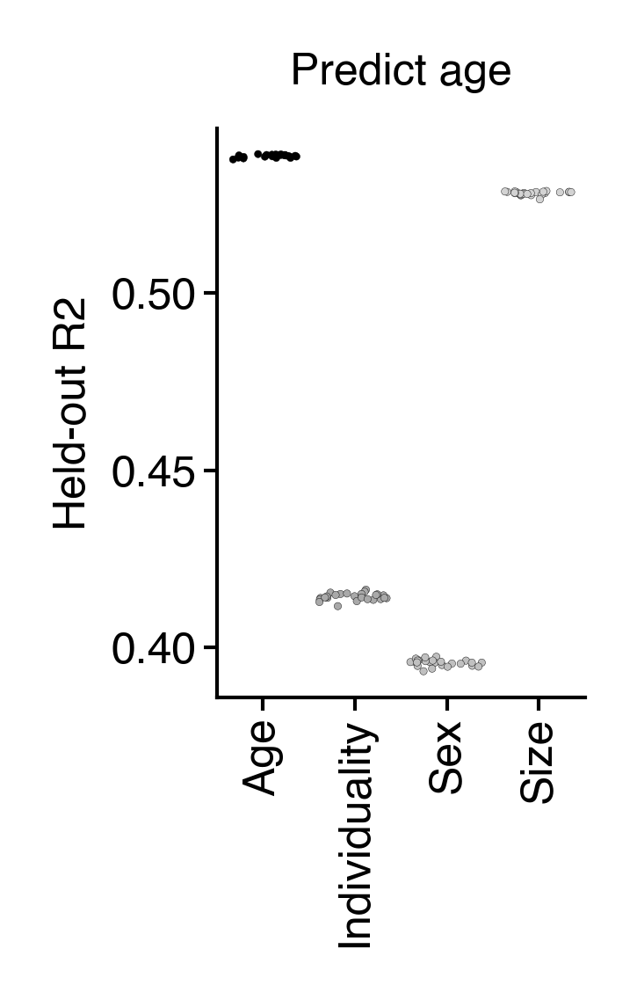

In [97]:
n_repeats = 25
x = []

for rank_grp, _df in filt_sylls.items():
    for i in range(n_repeats):
        preds = cross_val_predict(
            pipe,
            np.array(syllable_counts_jax[:, _df.values]),
            clf_data["age"],
            # clf_data["bio_age"],
            cv=KFold(n_splits=5, shuffle=True, random_state=i),
            n_jobs=-1,
        )
        x.append(
            {"r2": r2_score(clf_data["age"], preds), "type": rank_grp.capitalize()}
        )
x = pd.DataFrame(x)


fig = figure(0.9, 1.4)
ax = sns.stripplot(
    data=x,
    x="type",
    y="r2",
    hue="type",
    palette=["k", "darkgray", "silver", "lightgray"],
    size=1,
    linewidth=0.05,
    jitter=0.4,
)
plt.xticks(rotation=90)
ax.set(ylabel="Held-out R2", xlabel="", title="Predict age")
sns.despine()
# saver(fig, "predict-age-from-syllables", tight_layout=True);

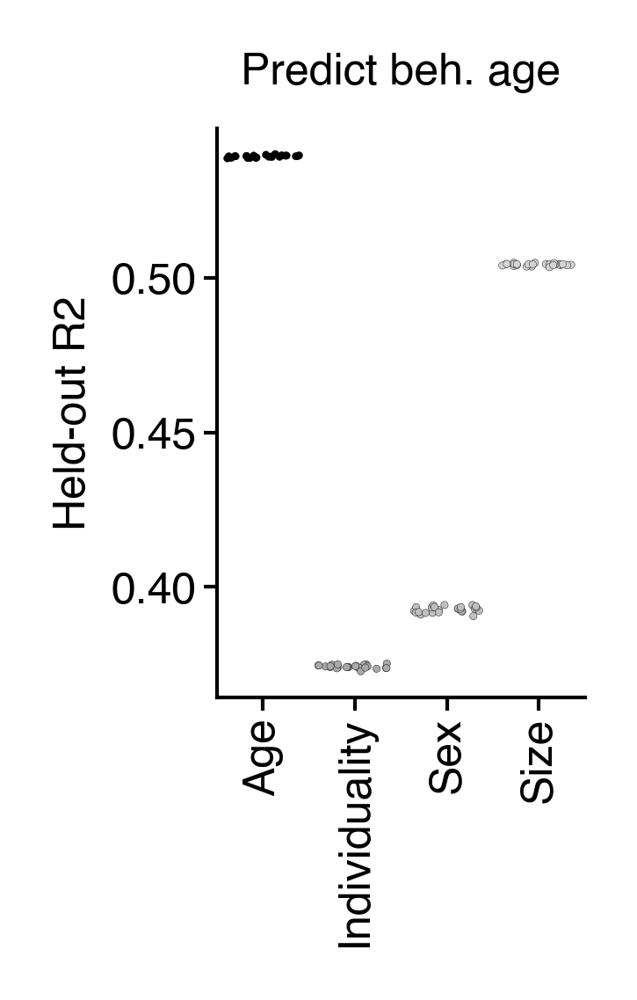

In [98]:
n_repeats = 25
x = []

for rank_grp, _df in filt_sylls.items():
    for i in range(n_repeats):
        preds = cross_val_predict(
            pipe,
            np.array(syllable_counts_jax[:, _df.values]),
            clf_data["bio_age"],
            cv=KFold(n_splits=5, shuffle=True, random_state=i),
            n_jobs=-1,
        )
        x.append(
            {"r2": r2_score(clf_data["age"], preds), "type": rank_grp.capitalize()}
        )
x = pd.DataFrame(x)


fig = figure(0.9, 1.4)
ax = sns.stripplot(
    data=x,
    x="type",
    y="r2",
    hue="type",
    palette=["k", "darkgray", "silver", "lightgray"],
    size=1,
    linewidth=0.05,
    jitter=0.4,
)
plt.xticks(rotation=90)
ax.set(ylabel="Held-out R2", xlabel="", title="Predict beh. age")
sns.despine()
# saver(fig, "predict-beh-age-from-syllables", tight_layout=True);

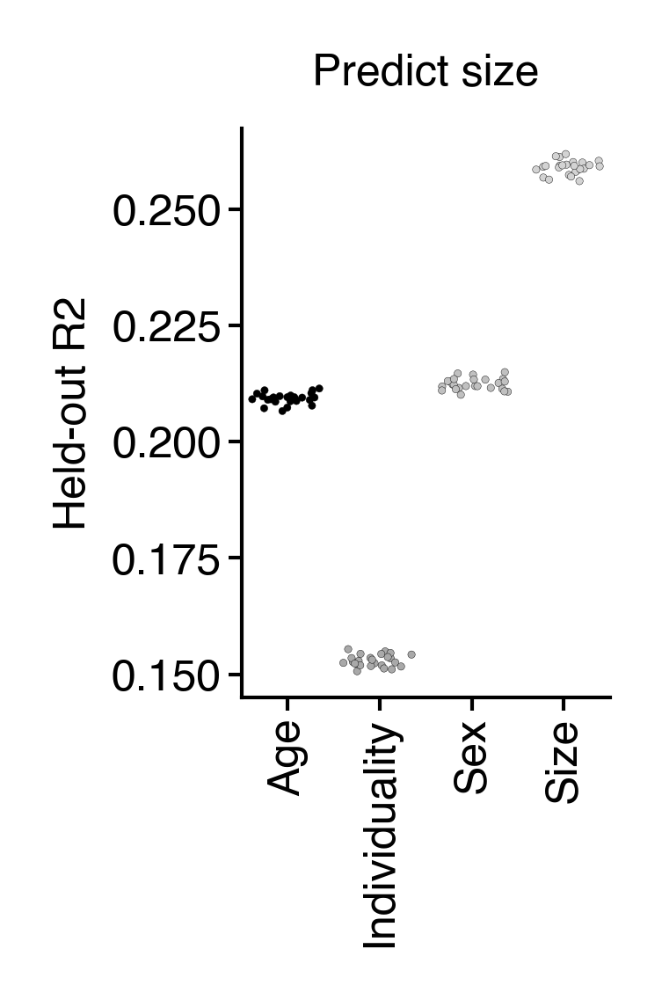

In [99]:
n_repeats = 25
x = []

y = np.array(features['sizes'])

for rank_grp, _df in filt_sylls.items():
    for i in range(n_repeats):
        preds = cross_val_predict(
            pipe,
            np.array(syllable_counts_jax[:, _df.values]),
            y,
            cv=KFold(n_splits=5, shuffle=True, random_state=i),
            n_jobs=-1,
        )
        x.append(
            {"r2": r2_score(y, preds), "type": rank_grp.capitalize()}
        )
x = pd.DataFrame(x)


fig = figure(0.9, 1.4)
ax = sns.stripplot(
    data=x,
    x="type",
    y="r2",
    hue="type",
    palette=["k", "darkgray", "silver", "lightgray"],
    size=1,
    linewidth=0.05,
    jitter=0.4,
)
plt.xticks(rotation=90)
ax.set(ylabel="Held-out R2", xlabel="", title="Predict size")
sns.despine()
# saver(fig, "predict-size-from-syllables", tight_layout=True);

In [100]:
clf_pipe = make_pipeline(
    StandardScaler(),
    SVC(kernel='linear', class_weight='balanced'),
)

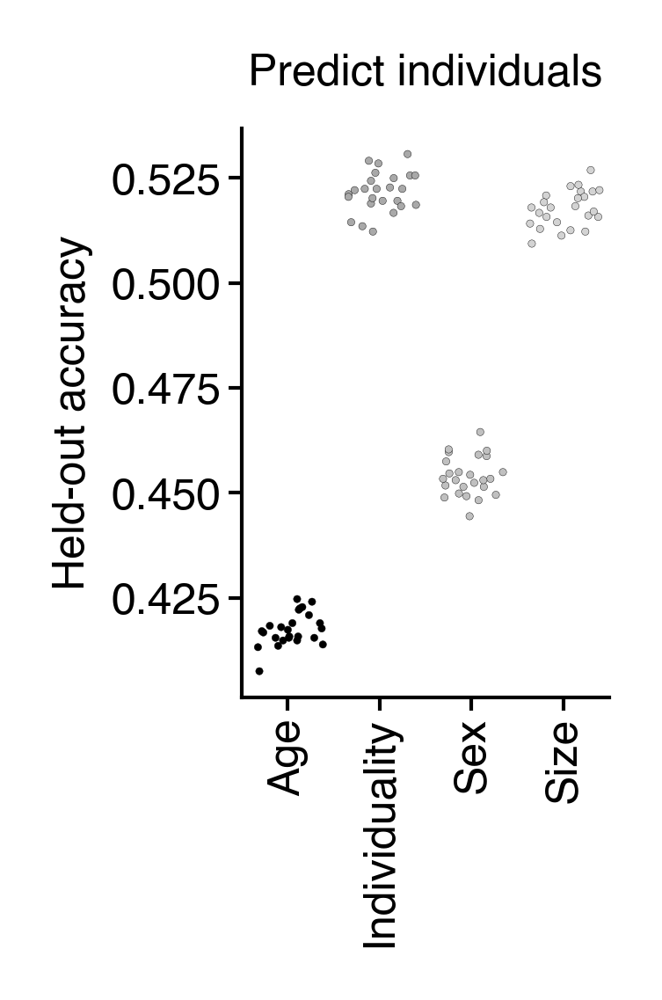

In [101]:
n_repeats = 25
x = []

y = np.argmax(features['mice'], axis=0)

for rank_grp, _df in filt_sylls.items():
    for i in range(n_repeats):
        preds = cross_val_predict(
            clf_pipe,
            np.array(syllable_counts_jax[:, _df.values]),
            y,
            cv=KFold(n_splits=5, shuffle=True, random_state=i),
            n_jobs=-1,
        )
        x.append(
            {"acc": accuracy_score(y, preds), "type": rank_grp.capitalize()}
        )
x = pd.DataFrame(x)


fig = figure(0.9, 1.4)
ax = sns.stripplot(
    data=x,
    x="type",
    y="acc",
    hue="type",
    palette=["k", "darkgray", "silver", "lightgray"],
    size=1,
    linewidth=0.05,
    jitter=0.4,
)
plt.xticks(rotation=90)
ax.set(ylabel="Held-out accuracy", xlabel="", title="Predict individuals")
sns.despine()
# saver(fig, "predict-indiv-from-syllables", tight_layout=True);

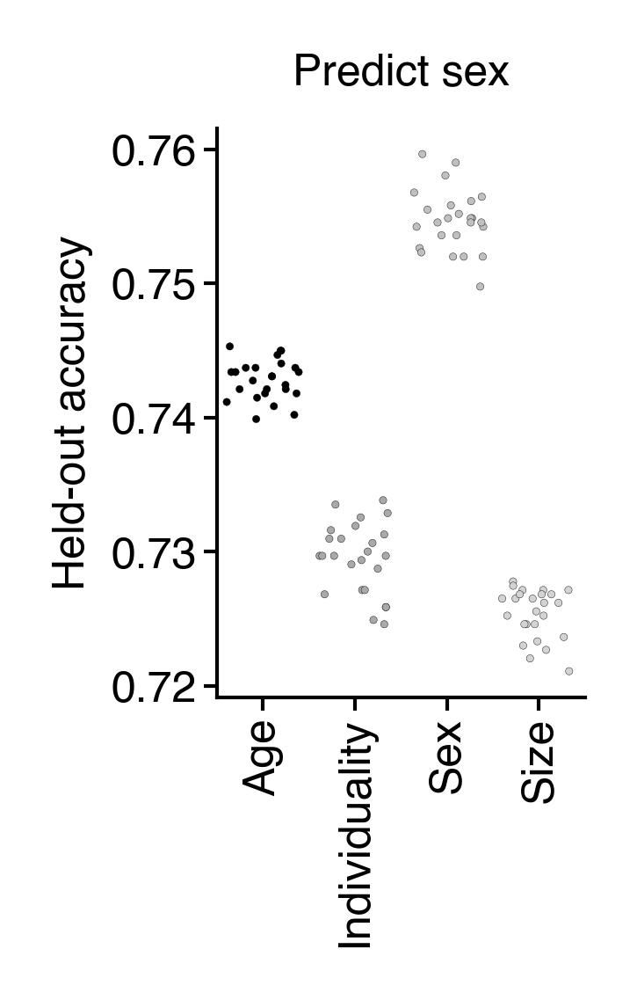

In [102]:
n_repeats = 25
x = []

y = np.argmax(features['sex'], axis=0)

for rank_grp, _df in filt_sylls.items():
    for i in range(n_repeats):
        preds = cross_val_predict(
            clf_pipe,
            np.array(syllable_counts_jax[:, _df.values]),
            y,
            cv=KFold(n_splits=5, shuffle=True, random_state=i),
            n_jobs=-1,
        )
        x.append(
            {"acc": accuracy_score(y, preds), "type": rank_grp.capitalize()}
        )
x = pd.DataFrame(x)


fig = figure(0.9, 1.4)
ax = sns.stripplot(
    data=x,
    x="type",
    y="acc",
    hue="type",
    palette=["k", "darkgray", "silver", "lightgray"],
    size=1,
    linewidth=0.05,
    jitter=0.4,
)
plt.xticks(rotation=90)
ax.set(ylabel="Held-out accuracy", xlabel="", title="Predict sex")
sns.despine()
# saver(fig, "predict-sex-from-syllables", tight_layout=True);

## Example mouse syllable counts and predictions

In [103]:
lenc = LabelEncoder()
labels = lenc.fit_transform(df.index.get_level_values("mouse").to_numpy())

In [104]:
# example_mice = [11, 7, 0, 10]
example_mice = [5, 10, 20, 25]

mask = []
for m in example_mice:
    mask.append(labels == m)
mask = reduce(or_, mask)

# sylls = [0, 1, 3, 5, 10, 14, 15]
sylls = [0, 1, 3, 5, 6, 8, 10, 14, 15, 19, 23]
fig, ax = plt.subplots(len(sylls), 3, figsize=(3, len(sylls)), sharex=True, dpi=900)

true_age = mdl["true_ages"][mask]
bio_age = mdl["bio_ages"][mask]
counts = mdl["counts"][mask]
pred_counts = mdl["predicted_counts"][mask]

for a, syll, i in zip(ax, map(lambda i: int(sort_idx[i]), sylls), sylls):
    max_counts = max([counts[:, syll].max(), pred_counts[:, syll].max()]) * 1.05
    a[0].scatter(true_age, counts[:, syll], s=2.5, c=labels[mask], cmap=cc.cm.glasbey, vmax=256, vmin=0, rasterized=True)
    a[0].set(title=f"Idx {i} Syllable {df.columns[syll]}", ylabel="Counts", xlabel="Chron. age (weeks)", ylim=(0, max_counts))

    a[2].scatter(bio_age, pred_counts[:, syll], s=2.5, c=labels[mask], cmap=cc.cm.glasbey, vmax=256, vmin=0, rasterized=True)
    a[2].set(ylabel="Pred. counts", xlabel="Beh. age (weeks)", ylim=(0, max_counts), yticklabels=[])

    a[1].scatter(bio_age, counts[:, syll], s=2.5, c=labels[mask], cmap=cc.cm.glasbey, vmax=256, vmin=0, rasterized=True)
    a[1].set(ylabel="Counts", xlabel="Beh. age (weeks)", ylim=(0, max_counts), yticklabels=[])

sns.despine()
fig.tight_layout()
saver(fig, "longtogeny-true-vs-predicted-counts");

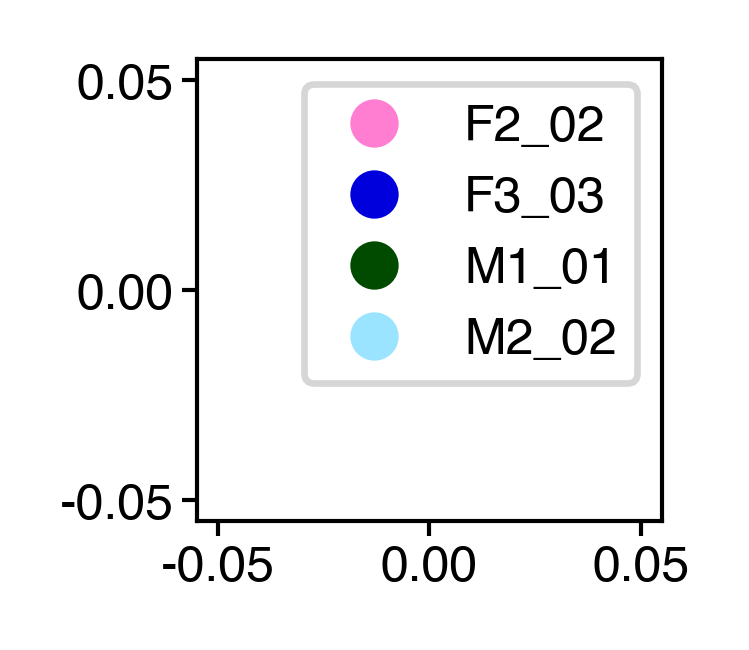

In [105]:
fig = figure(1, 1)
for idx in example_mice:
    plt.plot([], [], 'o', color=cc.glasbey[idx], label=lenc.classes_[idx])
plt.legend()
saver(fig, 'indiv-legend');

## Fit a strong-prior model

Beh. age should == chron age

In [106]:
hyp_copy = deepcopy(hypparams)
hyp_copy['age_sd'] = 1e-3
mdl = fit_model(features, hyp_copy, 6)

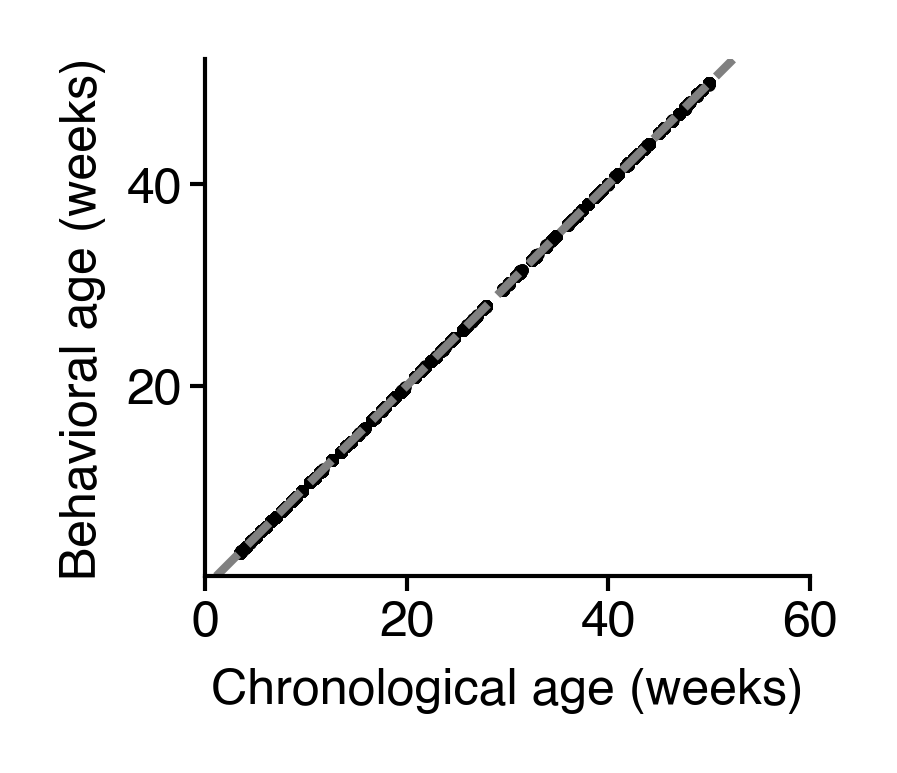

In [107]:
fig = figure(1.3, 1.3)
ax = fig.gca()
ax.scatter(mdl["true_ages"], mdl["bio_ages"], color="k", s=0.5)
ax.set(
    xlabel="Chronological age (weeks)",
    ylabel="Behavioral age (weeks)",
    aspect="equal",
    xlim=(0, 60),
)
add_identity(ax, color="gray", ls="--", zorder=1)
sns.despine()
saver(fig, "long-v2-bio-ages-strong-prior");

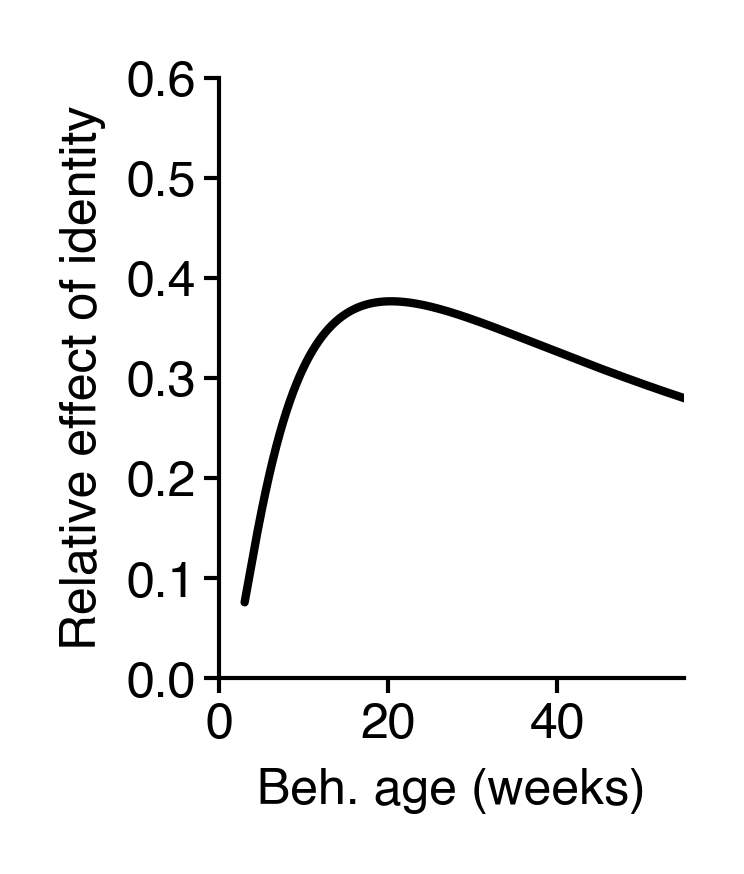

In [108]:
x = mdl['params']['development_weights']
dev = (x @ mdl['init_components'].bases['development']).squeeze()

comps = mdl['init_components']

dev = np.exp(dev)

fig = figure(1, 1.3)
ax = fig.gca()
ax.plot(comps.age_unnormalizer(comps.age_samples), dev, color='k')
plt.xlim(0, 55)
plt.ylim(0, 0.6)
plt.xlabel("Beh. age (weeks)")
plt.ylabel("Relative effect of identity")
sns.despine()
saver(fig, "long-v2-effect-of-id-strong-prior");

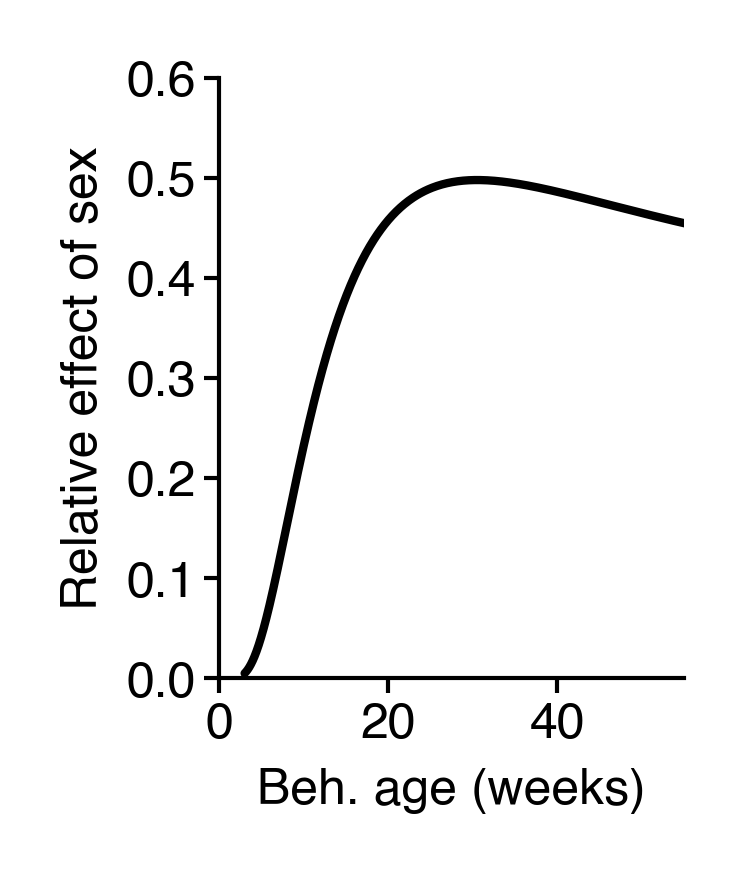

In [109]:
x = mdl['params']['sex_weights']
dev = (x @ mdl['init_components'].bases['sex']).squeeze()

comps = mdl['init_components']

dev = np.exp(dev)

fig = figure(1, 1.3)
ax = fig.gca()
ax.plot(comps.age_unnormalizer(comps.age_samples), dev, color='k')
plt.xlim(0, 55)
plt.ylim(0, 0.6)
plt.xlabel("Beh. age (weeks)")
plt.ylabel("Relative effect of sex")
sns.despine()
saver(fig, "long-v2-effect-of-sex-strong-prior");

## Show shuffles

In [110]:
from scipy.stats import ttest_ind

In [111]:
n_repeats = 30

In [112]:
hyp_copy = deepcopy(hypparams)
mdl4 = masked_xval(features, hyp_copy, 6, n_repeats=n_repeats)
r2_4 = list(pluck('heldout_r2_total_v3', mdl4.values()))
ll_4 = list(pluck('heldout_ll', mdl4.values()))
print(np.mean(r2_4))
del mdl4

  0%|          | 0/30 [00:00<?, ?it/s]

0.6620095128202788


In [113]:
hyp_copy = deepcopy(hypparams)
mdl5 = masked_xval(features, hyp_copy, 5, n_repeats=n_repeats)
r2_5 = list(pluck('heldout_r2_total_v3', mdl5.values()))
ll_5 = list(pluck('heldout_ll', mdl5.values()))
print(np.mean(r2_5))
del mdl5

  0%|          | 0/30 [00:00<?, ?it/s]

0.6603292942699135


In [114]:
ttest_ind(r2_5, r2_4, alternative='less')

TtestResult(statistic=-3.317810188123068, pvalue=0.0007853238858660021, df=58.0)

In [115]:
hyp_copy = deepcopy(hypparams)
mdl0 = masked_xval(features, hyp_copy, 0, n_repeats=n_repeats)
r2_0 = list(pluck('heldout_r2_total_v3', mdl0.values()))
ll_0 = list(pluck('heldout_ll', mdl0.values()))
print(np.mean(r2_0))
del mdl0

  0%|          | 0/30 [00:00<?, ?it/s]

0.3767717136693838


In [116]:
hyp_copy = deepcopy(hypparams)
mdl1 = masked_xval(features, hyp_copy, 1, n_repeats=n_repeats)
r2_1 = list(pluck('heldout_r2_total_v3', mdl1.values()))
ll_1 = list(pluck('heldout_ll', mdl1.values()))
print(np.mean(r2_1))
del mdl1

  0%|          | 0/30 [00:00<?, ?it/s]

0.4579344209567581


In [117]:
hyp_copy = deepcopy(hypparams)
mdl2 = masked_xval(features, hyp_copy, 2, n_repeats=n_repeats, )
r2_2 = list(pluck('heldout_r2_total_v3', mdl2.values()))
ll_2 = list(pluck('heldout_ll', mdl2.values()))
print(np.mean(r2_2))
del mdl2

  0%|          | 0/30 [00:00<?, ?it/s]

0.4775446953920149


In [ ]:
features_copy = deepcopy(features)
hyp_copy = deepcopy(hypparams)
features_copy['mice'], features_copy['sex'] = features_copy['sex'], features_copy['mice']
hyp_copy['n_animals'] = len(sex_id)
mdl3 = masked_xval(features_copy, hyp_copy, 5, n_repeats=n_repeats)
r2_3 = list(pluck('heldout_r2_total_v3', mdl3.values()))
ll_3 = list(pluck('heldout_ll', mdl3.values()))
print(np.mean(r2_3))
del mdl3

  0%|          | 0/30 [00:00<?, ?it/s]

In [119]:
# move features back
hyp_copy = deepcopy(hypparams)
hyp_copy['age_sd'] = 1e-6

mdl0_1 = masked_xval(features, hyp_copy, 1, n_repeats=n_repeats)
r2_0_1 = list(pluck('heldout_r2_total_v3', mdl0_1.values()))
ll_0_1 = list(pluck('heldout_ll', mdl0_1.values()))
print(np.mean(r2_0_1))
del mdl0_1

0.20251844540169855


In [120]:
# shuffle syllables
np.random.seed(0)
shuff_features = deepcopy(features)
hyp_copy = deepcopy(hypparams)
hyp_copy["age_sd"] = age_sd
hyp_copy['n_opt_iter'] = 650

r2_shuff = []
ll_shuff = []
for i in tqdm(range(n_repeats)):
    perm = np.array(
        [np.random.permutation(58) for _ in range(len(syllable_counts_jax))]
    )
    shuff = syllable_counts_jax[np.arange(len(syllable_counts_jax))[:, None], perm]
    shuff_features["counts"] = shuff
    tmp = masked_xval(
        shuff_features,
        hyp_copy,
        model_version=6,
        n_repeats=1,
        seed=i,
        disable_tqdm=True,
        return_loss_on_error=True,
    )
    if len(tmp[0]) > 1:
        r2_shuff.append(tmp[0]["heldout_r2_total_v3"])
        ll_shuff.append(tmp[0]['heldout_ll'])
    else:
        print(
            "Non-NaN iterations:",
            hyp_copy["n_opt_iter"] - np.isnan(tmp[0]["loss"]).sum(),
        )
print(np.mean(r2_shuff))

  0%|          | 0/30 [00:00<?, ?it/s]

182178
Non-NaN iterations: 629
182178
Non-NaN iterations: 642
182178
Non-NaN iterations: 544
182178
Non-NaN iterations: 747
182178
Non-NaN iterations: 704
182178
Non-NaN iterations: 583
182178
Non-NaN iterations: 708
182178
Non-NaN iterations: 695
182178
Non-NaN iterations: 663
182178
Non-NaN iterations: 677
182178
Non-NaN iterations: 625
182178
Non-NaN iterations: 662
-0.3456532896046184


In [121]:
# shuffle identity
np.random.seed(0)

hyp_copy = deepcopy(hypparams)
shuff_features = deepcopy(features)

shuff_r2s = []
shuff_lls = []
for i in tqdm(range(n_repeats)):
    shuff_features["mice"] = np.random.permutation(features["mice"].T).T
    shuff_results = masked_xval(
        shuff_features,
        hyp_copy,
        model_version=6,
        n_repeats=1,
        disable_tqdm=True,
        seed=i,
    )
    shuff_r2s.append(shuff_results[0]["heldout_r2_total_v3"])
    shuff_lls.append(shuff_results[0]['heldout_ll'])
print(np.mean(shuff_r2s))

  0%|          | 0/30 [00:00<?, ?it/s]

0.48411489805119223


In [122]:
# shuffle sexes
np.random.seed(0)

hyp_copy = deepcopy(hypparams)
shuff_features = deepcopy(features)

sex_shuff_r2s = []
sex_shuff_lls = []
for i in tqdm(range(n_repeats)):
    shuff_features["sex"] = np.random.permutation(features["sex"].T).T
    shuff_results = masked_xval(
        shuff_features,
        hyp_copy,
        model_version=6,
        n_repeats=1,
        disable_tqdm=True,
        seed=i,
    )
    sex_shuff_r2s.append(shuff_results[0]["heldout_r2_total_v3"])
    sex_shuff_lls.append(shuff_results[0]['heldout_ll'])
print(np.mean(sex_shuff_r2s))

  0%|          | 0/30 [00:00<?, ?it/s]

0.6401797981197394


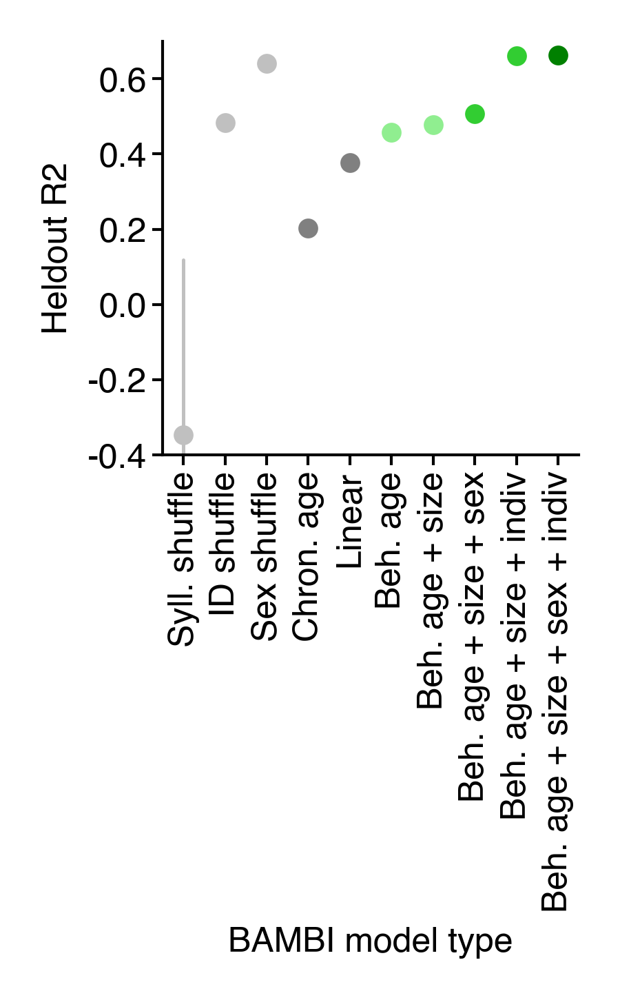

In [127]:
plt_data = {
    "Syll. shuffle": r2_shuff,
    "ID shuffle": shuff_r2s,
    "Sex shuffle": sex_shuff_r2s,
    "Chron. age": r2_0_1,
    "Linear": r2_0,
    "Beh. age": r2_1,
    "Beh. age + size": r2_2,
    "Beh. age + size + sex": r2_3,
    "Beh. age + size + indiv": r2_5,
    "Beh. age + size + sex + indiv": r2_4,
}

fig = figure(1.3, 1.3)
ax = sns.pointplot(
    data=plt_data,
    palette=[
        "silver",
        "silver",
        "silver",
        "gray",
        "gray",
        "lightgreen",
        "lightgreen",
        "limegreen",
        "limegreen",
        "green",
    ],
    linewidth=0.6,
    errorbar=("sd", 2),
    ms=3,
)
ax.set(
    xlabel="BAMBI model type",
    ylabel="Heldout R2",
    ylim=(-0.4, 0.7),
)
plt.xticks(rotation=90)
sns.despine()
saver(fig, "long-v2-males-females-heldout-r2-model-comparison");

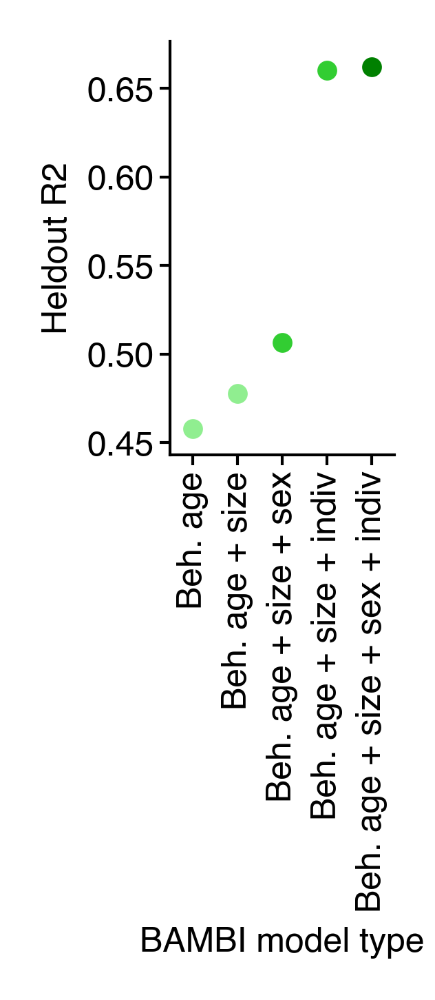

In [124]:
plt_data = {
    "Beh. age": r2_1,
    "Beh. age + size": r2_2,
    "Beh. age + size + sex": r2_3,
    "Beh. age + size + indiv": r2_5,
    "Beh. age + size + sex + indiv": r2_4,
}

fig = figure(0.7, 1.3)
ax = sns.pointplot(
    data=plt_data,
    palette=["lightgreen", "lightgreen", "limegreen", "limegreen", "green"],
    linewidth=0.6, errorbar=('sd', 2), ms=3
)
ax.set(
    xlabel="BAMBI model type",
    ylabel="Heldout R2",
)
plt.xticks(rotation=90)
sns.despine()
saver(fig, "long-v2-males-females-heldout-r2-model-comparison-just-bambi");

In [125]:
def create_broken_axis_plot(y_values, colors, order, figsize=(2, 2)):
    """
    Create a broken axis plot with 3 subplots. Made with Claude 3.5's help.

    Parameters:
    x_values (list): List of 3 numpy arrays, each containing x values for a subplot.
    y_values (list): List of 3 numpy arrays, each containing y values for a subplot.
    y_limits (list): List of 3 tuples, each containing (ymin, ymax) for a subplot.
    figsize (tuple): Figure size (width, height) in inches.
    title (str): Title of the plot.
    """

    # Create the figure and axes
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, sharex=True, figsize=figsize)
    fig.subplots_adjust(hspace=0.09)  # Adjust space between axes

    # Plot the data
    axes = [ax1, ax2, ax3]
    for ax, y, palette in zip(axes, y_values, colors):
        sns.pointplot(
            data=y,
            palette=palette,
            order=list(all_ll_plot_data),
            linewidth=0.6, errorbar=('sd', 2), ms=3,
            ax=ax
        )
        sns.despine(ax=ax, top=True)
        # ax.set_ylim(ymin, ymax)

    # Hide the spines between axes
    for ax in axes[:-1]:
        ax.spines['bottom'].set_visible(False)
        ax.tick_params(labeltop=False)
    axes[-1].xaxis.tick_bottom()

    # Add diagonal lines to indicate the breaks
    d = .015  # Size of diagonal lines
    for ax in axes:
        kwargs = dict(transform=ax.transAxes, color='k', clip_on=False)
        ax.plot((-d, +d), (-d, +d), **kwargs)
        # ax.plot((1 - d, 1 + d), (-d, +d), **kwargs)
        ax.plot((-d, +d), (1 - d, 1 + d), **kwargs)
        # ax.plot((1 - d, 1 + d), (1 - d, 1 + d), **kwargs)

    # Add labels and title
    for ax in axes:
        ax.set_ylabel('Heldout LL')
    axes[-1].tick_params(axis='x', rotation=90)
    return fig

In [130]:
all_ll_plot_data = {
    "Syll. shuffle": ll_shuff,
    "ID shuffle": shuff_lls,
    "Sex shuffle": sex_shuff_lls,
    "Chron. age": ll_0_1,
    "Linear": ll_0,
    "Beh. age": ll_1,
    "Beh. age + size": ll_2,
    "Beh. age + size + sex": ll_3,
    "Beh. age + size + indiv": ll_5,
    "Beh. age + size + sex + indiv": ll_4,
}

palette = [
    "silver",
    "silver",
    "silver",
    "gray",
    "gray",
    "lightgreen",
    "lightgreen",
    "limegreen",
    "limegreen",
    "green",
]

/tmp/ipykernel_26068/1196205493.py:2: UserWarning: 
The palette list has fewer values (2) than needed (10) and will cycle, which may produce an uninterpretable plot.
  ax = sns.pointplot(


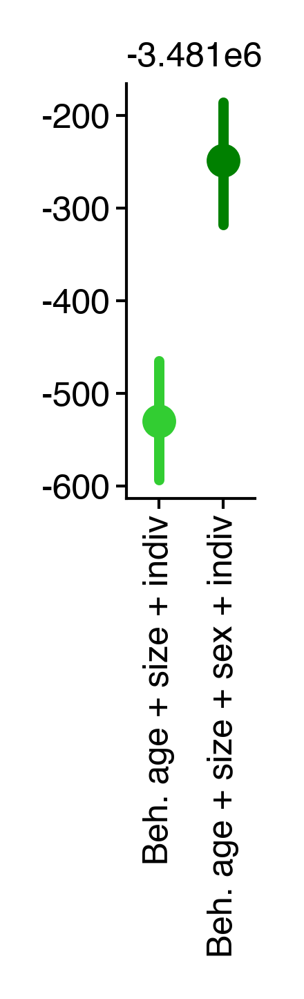

In [140]:
fig = figure(0.4, 1.3)
ax = sns.pointplot(
    data=all_ll_plot_data,
    order=["Beh. age + size + indiv", "Beh. age + size + sex + indiv"],
    palette=["limegreen", "green"],
)
ax.tick_params(axis='x', rotation=90)
sns.despine()
saver(fig, "just-last-two-heldout-ll");

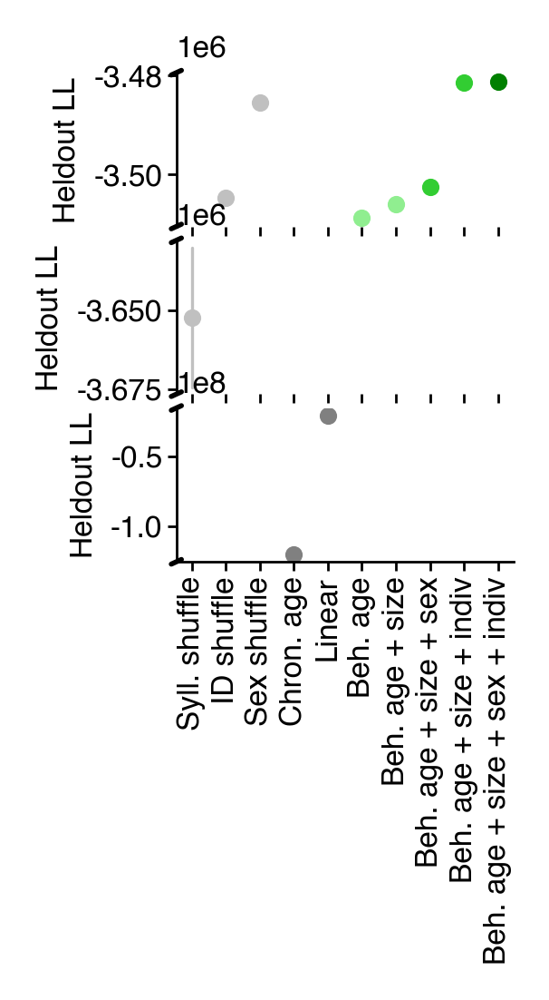

In [135]:
data_list = [
    {
        "ID shuffle": shuff_lls,
        "Sex shuffle": sex_shuff_lls,
        "Beh. age": ll_1,
        "Beh. age + size": ll_2,
        "Beh. age + size + sex": ll_3,
        "Beh. age + size + indiv": ll_5,
        "Beh. age + size + sex + indiv": ll_4,
    },
    {
        "Syll. shuffle": ll_shuff,
    },
    {
        "Chron. age": ll_0_1,
        "Linear": ll_0,
    },
]
fig = create_broken_axis_plot(
    data_list,
    colors=[
        ["silver", "silver", "lightgreen", "lightgreen", "limegreen", "limegreen", "green"],
        ["silver"],
        ["gray", "gray"],
    ],
    order=list(all_ll_plot_data),
    figsize=(1.2, 1.75)
)
saver(fig, "heldout-ll-broken-axis-plot");

In [ ]:
plt_data = {
    "Syll. shuffle": r2_shuff,
    "ID shuffle": shuff_r2s,
    "Sex shuffle": sex_shuff_r2s,
    "Chron. age": r2_0_1,
    "Linear": r2_0,
    "Beh. age": r2_1,
    "Beh. age + size": r2_2,
    "Beh. age + size + sex": r2_3,
    "Beh. age + size + indiv": r2_5,
    "Beh. age + size + sex + indiv": r2_4,
}

fig = figure(1.3, 1.3)
ax = sns.pointplot(
    data=plt_data,
    palette=[
        "silver",
        "silver",
        "silver",
        "gray",
        "gray",
        "lightgreen",
        "lightgreen",
        "limegreen",
        "limegreen",
        "green",
    ],
    linewidth=0.6,
    errorbar=("sd", 2),
    ms=3,
)
ax.set(
    xlabel="BAMBI model type",
    ylabel="Heldout R2",
    ylim=(-0.3, 0.7),
)
plt.xticks(rotation=90)
sns.despine()
saver(fig, "long-v2-males-females-heldout-r2-model-comparison");